# Session (475165_f1_stage2_day6)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f1_stage2_day6" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f1"
day = "day6"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (36146, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


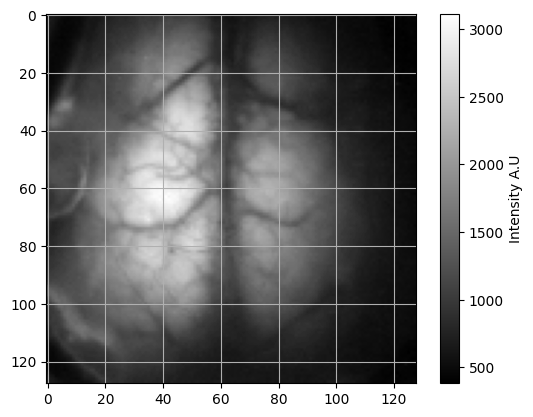

frame number 6000 plotted


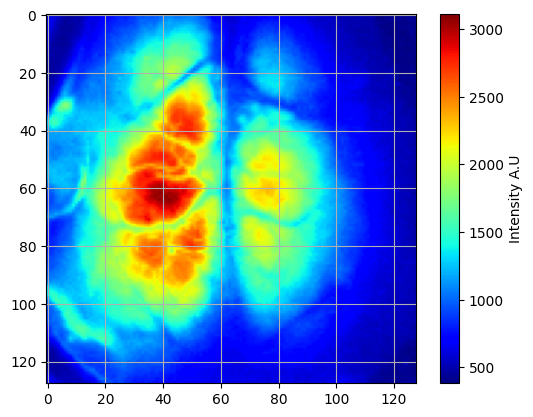

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 444.6126708984375 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 500.1892547607422


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 82
Number of double_flash pairs: 41
Number of single_flash: 48
Number of total flashes: 130


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/130 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/130 [00:01<03:01,  1.41s/it]

  2%|█▎                                                                                | 2/130 [00:02<03:00,  1.41s/it]

  2%|█▉                                                                                | 3/130 [00:04<02:59,  1.41s/it]

  3%|██▌                                                                               | 4/130 [00:05<02:51,  1.36s/it]

  4%|███▏                                                                              | 5/130 [00:06<02:47,  1.34s/it]

  5%|███▊                                                                              | 6/130 [00:08<02:53,  1.40s/it]

  5%|████▍                                                                             | 7/130 [00:09<02:52,  1.40s/it]

  6%|█████                                                                             | 8/130 [00:11<02:49,  1.39s/it]

  7%|█████▋                                                                            | 9/130 [00:12<02:49,  1.40s/it]

  8%|██████▏                                                                          | 10/130 [00:13<02:50,  1.42s/it]

  8%|██████▊                                                                          | 11/130 [00:15<02:46,  1.40s/it]

  9%|███████▍                                                                         | 12/130 [00:16<02:44,  1.40s/it]

 10%|████████                                                                         | 13/130 [00:18<02:40,  1.37s/it]

 11%|████████▋                                                                        | 14/130 [00:19<02:39,  1.38s/it]

 12%|█████████▎                                                                       | 15/130 [00:20<02:39,  1.38s/it]

 12%|█████████▉                                                                       | 16/130 [00:22<02:32,  1.34s/it]

 13%|██████████▌                                                                      | 17/130 [00:23<02:32,  1.35s/it]

 14%|███████████▏                                                                     | 18/130 [00:24<02:29,  1.34s/it]

 15%|███████████▊                                                                     | 19/130 [00:26<02:33,  1.38s/it]

 15%|████████████▍                                                                    | 20/130 [00:27<02:31,  1.38s/it]

 16%|█████████████                                                                    | 21/130 [00:28<02:27,  1.35s/it]

 17%|█████████████▋                                                                   | 22/130 [00:30<02:27,  1.37s/it]

 18%|██████████████▎                                                                  | 23/130 [00:31<02:23,  1.34s/it]

 18%|██████████████▉                                                                  | 24/130 [00:33<02:25,  1.38s/it]

 19%|███████████████▌                                                                 | 25/130 [00:34<02:26,  1.39s/it]

 20%|████████████████▏                                                                | 26/130 [00:35<02:21,  1.36s/it]

 21%|████████████████▊                                                                | 27/130 [00:37<02:18,  1.35s/it]

 22%|█████████████████▍                                                               | 28/130 [00:38<02:18,  1.36s/it]

 22%|██████████████████                                                               | 29/130 [00:39<02:18,  1.37s/it]

 23%|██████████████████▋                                                              | 30/130 [00:41<02:14,  1.34s/it]

 24%|███████████████████▎                                                             | 31/130 [00:42<02:14,  1.36s/it]

 25%|███████████████████▉                                                             | 32/130 [00:43<02:14,  1.38s/it]

 25%|████████████████████▌                                                            | 33/130 [00:45<02:13,  1.38s/it]

 26%|█████████████████████▏                                                           | 34/130 [00:46<02:11,  1.37s/it]

 27%|█████████████████████▊                                                           | 35/130 [00:48<02:10,  1.37s/it]

 28%|██████████████████████▍                                                          | 36/130 [00:49<02:07,  1.36s/it]

 28%|███████████████████████                                                          | 37/130 [00:50<02:04,  1.34s/it]

 29%|███████████████████████▋                                                         | 38/130 [00:52<02:03,  1.34s/it]

 30%|████████████████████████▎                                                        | 39/130 [00:53<02:01,  1.33s/it]

 31%|████████████████████████▉                                                        | 40/130 [00:54<02:03,  1.37s/it]

 32%|█████████████████████████▌                                                       | 41/130 [00:56<02:01,  1.37s/it]

 32%|██████████████████████████▏                                                      | 42/130 [00:57<02:00,  1.37s/it]

 33%|██████████████████████████▊                                                      | 43/130 [00:58<02:00,  1.38s/it]

 34%|███████████████████████████▍                                                     | 44/130 [01:00<01:57,  1.36s/it]

 35%|████████████████████████████                                                     | 45/130 [01:01<01:57,  1.38s/it]

 35%|████████████████████████████▋                                                    | 46/130 [01:03<01:54,  1.36s/it]

 36%|█████████████████████████████▎                                                   | 47/130 [01:04<01:53,  1.37s/it]

 37%|█████████████████████████████▉                                                   | 48/130 [01:05<01:54,  1.40s/it]

 38%|██████████████████████████████▌                                                  | 49/130 [01:07<01:54,  1.41s/it]

 38%|███████████████████████████████▏                                                 | 50/130 [01:08<01:50,  1.38s/it]

 39%|███████████████████████████████▊                                                 | 51/130 [01:09<01:47,  1.36s/it]

 40%|████████████████████████████████▍                                                | 52/130 [01:11<01:45,  1.35s/it]

 41%|█████████████████████████████████                                                | 53/130 [01:12<01:44,  1.35s/it]

 42%|█████████████████████████████████▋                                               | 54/130 [01:13<01:43,  1.36s/it]

 42%|██████████████████████████████████▎                                              | 55/130 [01:15<01:40,  1.35s/it]

 43%|██████████████████████████████████▉                                              | 56/130 [01:16<01:40,  1.35s/it]

 44%|███████████████████████████████████▌                                             | 57/130 [01:18<01:39,  1.37s/it]

 45%|████████████████████████████████████▏                                            | 58/130 [01:19<01:38,  1.36s/it]

 45%|████████████████████████████████████▊                                            | 59/130 [01:20<01:34,  1.33s/it]

 46%|█████████████████████████████████████▍                                           | 60/130 [01:22<01:34,  1.35s/it]

 47%|██████████████████████████████████████                                           | 61/130 [01:23<01:33,  1.35s/it]

 48%|██████████████████████████████████████▋                                          | 62/130 [01:24<01:29,  1.32s/it]

 48%|███████████████████████████████████████▎                                         | 63/130 [01:26<01:31,  1.36s/it]

 49%|███████████████████████████████████████▉                                         | 64/130 [01:27<01:30,  1.38s/it]

 50%|████████████████████████████████████████▌                                        | 65/130 [01:28<01:27,  1.35s/it]

 51%|█████████████████████████████████████████                                        | 66/130 [01:30<01:27,  1.37s/it]

 52%|█████████████████████████████████████████▋                                       | 67/130 [01:31<01:25,  1.36s/it]

 52%|██████████████████████████████████████████▎                                      | 68/130 [01:32<01:23,  1.34s/it]

 53%|██████████████████████████████████████████▉                                      | 69/130 [01:34<01:22,  1.35s/it]

 54%|███████████████████████████████████████████▌                                     | 70/130 [01:35<01:20,  1.34s/it]

 55%|████████████████████████████████████████████▏                                    | 71/130 [01:36<01:17,  1.32s/it]

 55%|████████████████████████████████████████████▊                                    | 72/130 [01:38<01:18,  1.35s/it]

 56%|█████████████████████████████████████████████▍                                   | 73/130 [01:39<01:17,  1.37s/it]

 57%|██████████████████████████████████████████████                                   | 74/130 [01:41<01:16,  1.37s/it]

 58%|██████████████████████████████████████████████▋                                  | 75/130 [01:42<01:16,  1.38s/it]

 58%|███████████████████████████████████████████████▎                                 | 76/130 [01:43<01:13,  1.35s/it]

 59%|███████████████████████████████████████████████▉                                 | 77/130 [01:45<01:10,  1.33s/it]

 60%|████████████████████████████████████████████████▌                                | 78/130 [01:46<01:09,  1.34s/it]

 61%|█████████████████████████████████████████████████▏                               | 79/130 [01:47<01:08,  1.34s/it]

 62%|█████████████████████████████████████████████████▊                               | 80/130 [01:49<01:08,  1.37s/it]

 62%|██████████████████████████████████████████████████▍                              | 81/130 [01:50<01:06,  1.36s/it]

 63%|███████████████████████████████████████████████████                              | 82/130 [01:51<01:06,  1.39s/it]

 64%|███████████████████████████████████████████████████▋                             | 83/130 [01:53<01:04,  1.37s/it]

 65%|████████████████████████████████████████████████████▎                            | 84/130 [01:54<01:04,  1.40s/it]

 65%|████████████████████████████████████████████████████▉                            | 85/130 [01:56<01:01,  1.36s/it]

 66%|█████████████████████████████████████████████████████▌                           | 86/130 [01:57<01:01,  1.39s/it]

 67%|██████████████████████████████████████████████████████▏                          | 87/130 [01:58<00:59,  1.39s/it]

 68%|██████████████████████████████████████████████████████▊                          | 88/130 [02:00<00:58,  1.40s/it]

 68%|███████████████████████████████████████████████████████▍                         | 89/130 [02:01<00:57,  1.41s/it]

 69%|████████████████████████████████████████████████████████                         | 90/130 [02:03<00:57,  1.43s/it]

 70%|████████████████████████████████████████████████████████▋                        | 91/130 [02:04<00:56,  1.45s/it]

 71%|█████████████████████████████████████████████████████████▎                       | 92/130 [02:06<00:54,  1.44s/it]

 72%|█████████████████████████████████████████████████████████▉                       | 93/130 [02:07<00:52,  1.42s/it]

 72%|██████████████████████████████████████████████████████████▌                      | 94/130 [02:08<00:49,  1.38s/it]

 73%|███████████████████████████████████████████████████████████▏                     | 95/130 [02:10<00:48,  1.37s/it]

 74%|███████████████████████████████████████████████████████████▊                     | 96/130 [02:11<00:47,  1.39s/it]

 75%|████████████████████████████████████████████████████████████▍                    | 97/130 [02:12<00:45,  1.38s/it]

 75%|█████████████████████████████████████████████████████████████                    | 98/130 [02:14<00:42,  1.34s/it]

 76%|█████████████████████████████████████████████████████████████▋                   | 99/130 [02:15<00:42,  1.36s/it]

 77%|█████████████████████████████████████████████████████████████▌                  | 100/130 [02:16<00:40,  1.35s/it]

 78%|██████████████████████████████████████████████████████████████▏                 | 101/130 [02:18<00:38,  1.33s/it]

 78%|██████████████████████████████████████████████████████████████▊                 | 102/130 [02:19<00:38,  1.38s/it]

 79%|███████████████████████████████████████████████████████████████▍                | 103/130 [02:21<00:37,  1.37s/it]

 80%|████████████████████████████████████████████████████████████████                | 104/130 [02:22<00:34,  1.34s/it]

 81%|████████████████████████████████████████████████████████████████▌               | 105/130 [02:23<00:33,  1.34s/it]

 82%|█████████████████████████████████████████████████████████████████▏              | 106/130 [02:25<00:32,  1.36s/it]

 82%|█████████████████████████████████████████████████████████████████▊              | 107/130 [02:26<00:31,  1.38s/it]

 83%|██████████████████████████████████████████████████████████████████▍             | 108/130 [02:27<00:29,  1.36s/it]

 84%|███████████████████████████████████████████████████████████████████             | 109/130 [02:29<00:28,  1.38s/it]

 85%|███████████████████████████████████████████████████████████████████▋            | 110/130 [02:30<00:26,  1.35s/it]

 85%|████████████████████████████████████████████████████████████████████▎           | 111/130 [02:31<00:25,  1.33s/it]

 86%|████████████████████████████████████████████████████████████████████▉           | 112/130 [02:33<00:23,  1.33s/it]

 87%|█████████████████████████████████████████████████████████████████████▌          | 113/130 [02:34<00:22,  1.34s/it]

 88%|██████████████████████████████████████████████████████████████████████▏         | 114/130 [02:35<00:21,  1.34s/it]

 88%|██████████████████████████████████████████████████████████████████████▊         | 115/130 [02:37<00:20,  1.35s/it]

 89%|███████████████████████████████████████████████████████████████████████▍        | 116/130 [02:38<00:18,  1.35s/it]

 90%|████████████████████████████████████████████████████████████████████████        | 117/130 [02:39<00:17,  1.38s/it]

 91%|████████████████████████████████████████████████████████████████████████▌       | 118/130 [02:41<00:16,  1.38s/it]

 92%|█████████████████████████████████████████████████████████████████████████▏      | 119/130 [02:42<00:15,  1.37s/it]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 120/130 [02:44<00:13,  1.37s/it]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 121/130 [02:45<00:12,  1.35s/it]

 94%|███████████████████████████████████████████████████████████████████████████     | 122/130 [02:46<00:10,  1.36s/it]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 123/130 [02:48<00:09,  1.34s/it]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 124/130 [02:49<00:07,  1.32s/it]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 125/130 [02:50<00:06,  1.34s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 126/130 [02:51<00:05,  1.31s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 127/130 [02:53<00:03,  1.30s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 128/130 [02:54<00:02,  1.32s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 129/130 [02:55<00:01,  1.30s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 130/130 [02:57<00:00,  1.32s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 130/130 [02:57<00:00,  1.36s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 21%|████████████████▉                                                               | 27/128 [00:00<00:00, 264.80it/s]

 42%|█████████████████████████████████▊                                              | 54/128 [00:00<00:00, 229.12it/s]

 61%|████████████████████████████████████████████████▊                               | 78/128 [00:00<00:00, 214.90it/s]

 81%|████████████████████████████████████████████████████████████████▏              | 104/128 [00:00<00:00, 228.45it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 234.51it/s]

  0%|                                                                                        | 0/35981 [00:00<?, ?it/s]

  0%|                                                                              | 26/35981 [00:00<02:18, 258.77it/s]

  0%|                                                                              | 52/35981 [00:00<02:28, 241.14it/s]

  0%|▏                                                                             | 77/35981 [00:00<02:44, 217.86it/s]

  0%|▏                                                                            | 103/35981 [00:00<02:36, 229.67it/s]

  0%|▎                                                                            | 132/35981 [00:00<02:23, 249.47it/s]

  0%|▎                                                                            | 160/35981 [00:00<02:18, 258.53it/s]

  1%|▍                                                                            | 187/35981 [00:00<02:17, 259.72it/s]

  1%|▍                                                                            | 214/35981 [00:00<02:21, 253.42it/s]

  1%|▌                                                                            | 240/35981 [00:00<02:21, 252.09it/s]

  1%|▌                                                                            | 269/35981 [00:01<02:17, 260.64it/s]

  1%|▋                                                                            | 296/35981 [00:01<02:15, 262.65it/s]

  1%|▋                                                                            | 323/35981 [00:01<02:17, 258.73it/s]

  1%|▊                                                                            | 353/35981 [00:01<02:12, 269.25it/s]

  1%|▊                                                                            | 380/35981 [00:01<02:12, 268.71it/s]

  1%|▊                                                                            | 407/35981 [00:01<02:14, 265.21it/s]

  1%|▉                                                                            | 435/35981 [00:01<02:13, 267.22it/s]

  1%|▉                                                                            | 462/35981 [00:01<02:28, 238.65it/s]

  1%|█                                                                            | 487/35981 [00:01<02:28, 239.80it/s]

  1%|█                                                                            | 515/35981 [00:02<02:21, 250.31it/s]

  2%|█▏                                                                           | 541/35981 [00:02<02:31, 233.84it/s]

  2%|█▏                                                                           | 565/35981 [00:02<02:33, 230.52it/s]

  2%|█▎                                                                           | 589/35981 [00:02<02:33, 231.24it/s]

  2%|█▎                                                                           | 618/35981 [00:02<02:23, 246.40it/s]

  2%|█▍                                                                           | 647/35981 [00:02<02:17, 256.67it/s]

  2%|█▍                                                                           | 676/35981 [00:02<02:13, 264.38it/s]

  2%|█▌                                                                           | 705/35981 [00:02<02:10, 270.27it/s]

  2%|█▌                                                                           | 733/35981 [00:02<02:13, 264.64it/s]

  2%|█▋                                                                           | 760/35981 [00:02<02:13, 263.93it/s]

  2%|█▋                                                                           | 788/35981 [00:03<02:11, 267.84it/s]

  2%|█▋                                                                           | 815/35981 [00:03<02:18, 253.33it/s]

  2%|█▊                                                                           | 841/35981 [00:03<02:19, 252.38it/s]

  2%|█▊                                                                           | 867/35981 [00:03<02:19, 251.71it/s]

  2%|█▉                                                                           | 893/35981 [00:03<02:23, 244.30it/s]

  3%|█▉                                                                           | 918/35981 [00:03<02:23, 244.55it/s]

  3%|██                                                                           | 943/35981 [00:03<02:23, 244.04it/s]

  3%|██                                                                           | 968/35981 [00:03<02:26, 238.89it/s]

  3%|██▏                                                                          | 997/35981 [00:03<02:18, 252.10it/s]

  3%|██▏                                                                         | 1025/35981 [00:04<02:15, 258.37it/s]

  3%|██▏                                                                         | 1051/35981 [00:04<02:16, 256.63it/s]

  3%|██▎                                                                         | 1077/35981 [00:04<02:20, 248.92it/s]

  3%|██▎                                                                         | 1105/35981 [00:04<02:16, 256.40it/s]

  3%|██▍                                                                         | 1133/35981 [00:04<02:12, 262.12it/s]

  3%|██▍                                                                         | 1160/35981 [00:04<02:18, 250.56it/s]

  3%|██▌                                                                         | 1186/35981 [00:04<02:22, 244.26it/s]

  3%|██▌                                                                         | 1212/35981 [00:04<02:20, 246.63it/s]

  3%|██▌                                                                         | 1240/35981 [00:04<02:16, 253.98it/s]

  4%|██▋                                                                         | 1267/35981 [00:05<02:15, 257.13it/s]

  4%|██▋                                                                         | 1293/35981 [00:05<02:19, 249.32it/s]

  4%|██▊                                                                         | 1319/35981 [00:05<02:20, 247.45it/s]

  4%|██▊                                                                         | 1347/35981 [00:05<02:15, 256.04it/s]

  4%|██▉                                                                         | 1373/35981 [00:05<02:15, 255.73it/s]

  4%|██▉                                                                         | 1399/35981 [00:05<02:15, 255.51it/s]

  4%|███                                                                         | 1425/35981 [00:05<02:19, 247.44it/s]

  4%|███                                                                         | 1450/35981 [00:05<02:21, 244.00it/s]

  4%|███                                                                         | 1475/35981 [00:05<02:20, 245.04it/s]

  4%|███▏                                                                        | 1503/35981 [00:05<02:15, 253.75it/s]

  4%|███▏                                                                        | 1532/35981 [00:06<02:11, 262.07it/s]

  4%|███▎                                                                        | 1559/35981 [00:06<02:14, 256.17it/s]

  4%|███▎                                                                        | 1589/35981 [00:06<02:09, 266.53it/s]

  4%|███▍                                                                        | 1619/35981 [00:06<02:05, 274.67it/s]

  5%|███▍                                                                        | 1649/35981 [00:06<02:02, 280.45it/s]

  5%|███▌                                                                        | 1678/35981 [00:06<02:07, 269.09it/s]

  5%|███▌                                                                        | 1706/35981 [00:06<02:08, 266.16it/s]

  5%|███▋                                                                        | 1734/35981 [00:06<02:07, 269.36it/s]

  5%|███▋                                                                        | 1762/35981 [00:06<02:07, 268.11it/s]

  5%|███▊                                                                        | 1790/35981 [00:07<02:06, 270.65it/s]

  5%|███▊                                                                        | 1818/35981 [00:07<02:08, 265.97it/s]

  5%|███▉                                                                        | 1846/35981 [00:07<02:08, 266.45it/s]

  5%|███▉                                                                        | 1873/35981 [00:07<02:11, 259.90it/s]

  5%|████                                                                        | 1903/35981 [00:07<02:07, 266.56it/s]

  5%|████                                                                        | 1932/35981 [00:07<02:05, 272.10it/s]

  5%|████▏                                                                       | 1962/35981 [00:07<02:02, 278.60it/s]

  6%|████▏                                                                       | 1990/35981 [00:07<02:06, 269.61it/s]

  6%|████▎                                                                       | 2018/35981 [00:07<02:10, 260.65it/s]

  6%|████▎                                                                       | 2047/35981 [00:07<02:06, 267.44it/s]

  6%|████▍                                                                       | 2074/35981 [00:08<02:08, 263.67it/s]

  6%|████▍                                                                       | 2101/35981 [00:08<02:14, 252.50it/s]

  6%|████▍                                                                       | 2127/35981 [00:08<02:14, 251.80it/s]

  6%|████▌                                                                       | 2157/35981 [00:08<02:08, 264.00it/s]

  6%|████▌                                                                       | 2186/35981 [00:08<02:04, 270.71it/s]

  6%|████▋                                                                       | 2214/35981 [00:08<02:04, 271.08it/s]

  6%|████▋                                                                       | 2242/35981 [00:08<02:05, 269.77it/s]

  6%|████▊                                                                       | 2272/35981 [00:08<02:02, 276.18it/s]

  6%|████▊                                                                       | 2300/35981 [00:08<02:04, 270.23it/s]

  6%|████▉                                                                       | 2328/35981 [00:09<02:08, 261.74it/s]

  7%|████▉                                                                       | 2356/35981 [00:09<02:08, 262.48it/s]

  7%|█████                                                                       | 2383/35981 [00:09<02:12, 253.81it/s]

  7%|█████                                                                       | 2409/35981 [00:09<02:13, 251.34it/s]

  7%|█████▏                                                                      | 2435/35981 [00:09<02:14, 248.88it/s]

  7%|█████▏                                                                      | 2464/35981 [00:09<02:10, 257.65it/s]

  7%|█████▎                                                                      | 2493/35981 [00:09<02:06, 263.92it/s]

  7%|█████▎                                                                      | 2520/35981 [00:09<02:17, 243.34it/s]

  7%|█████▍                                                                      | 2545/35981 [00:09<02:20, 238.66it/s]

  7%|█████▍                                                                      | 2570/35981 [00:10<02:21, 235.32it/s]

  7%|█████▍                                                                      | 2599/35981 [00:10<02:14, 248.43it/s]

  7%|█████▌                                                                      | 2625/35981 [00:10<02:20, 237.02it/s]

  7%|█████▌                                                                      | 2649/35981 [00:10<02:22, 234.00it/s]

  7%|█████▋                                                                      | 2677/35981 [00:10<02:16, 244.80it/s]

  8%|█████▋                                                                      | 2702/35981 [00:10<02:19, 238.20it/s]

  8%|█████▊                                                                      | 2729/35981 [00:10<02:16, 242.95it/s]

  8%|█████▊                                                                      | 2757/35981 [00:10<02:11, 252.32it/s]

  8%|█████▉                                                                      | 2783/35981 [00:10<02:20, 236.48it/s]

  8%|█████▉                                                                      | 2807/35981 [00:11<02:20, 236.17it/s]

  8%|█████▉                                                                      | 2835/35981 [00:11<02:14, 247.14it/s]

  8%|██████                                                                      | 2860/35981 [00:11<02:15, 244.36it/s]

  8%|██████                                                                      | 2888/35981 [00:11<02:10, 253.61it/s]

  8%|██████▏                                                                     | 2918/35981 [00:11<02:04, 265.55it/s]

  8%|██████▏                                                                     | 2948/35981 [00:11<02:00, 273.23it/s]

  8%|██████▎                                                                     | 2978/35981 [00:11<01:58, 279.45it/s]

  8%|██████▎                                                                     | 3008/35981 [00:11<01:56, 283.84it/s]

  8%|██████▍                                                                     | 3037/35981 [00:11<01:58, 277.52it/s]

  9%|██████▍                                                                     | 3065/35981 [00:11<01:58, 276.66it/s]

  9%|██████▌                                                                     | 3093/35981 [00:12<02:04, 263.82it/s]

  9%|██████▌                                                                     | 3120/35981 [00:12<02:04, 263.35it/s]

  9%|██████▋                                                                     | 3150/35981 [00:12<02:00, 271.55it/s]

  9%|██████▋                                                                     | 3178/35981 [00:12<02:02, 267.08it/s]

  9%|██████▊                                                                     | 3208/35981 [00:12<01:59, 274.19it/s]

  9%|██████▊                                                                     | 3237/35981 [00:12<01:58, 276.39it/s]

  9%|██████▉                                                                     | 3265/35981 [00:12<02:02, 266.63it/s]

  9%|██████▉                                                                     | 3294/35981 [00:12<02:00, 271.07it/s]

  9%|███████                                                                     | 3322/35981 [00:12<02:00, 272.11it/s]

  9%|███████                                                                     | 3350/35981 [00:13<02:01, 269.19it/s]

  9%|███████▏                                                                    | 3380/35981 [00:13<01:57, 276.66it/s]

  9%|███████▏                                                                    | 3408/35981 [00:13<02:10, 249.02it/s]

 10%|███████▎                                                                    | 3434/35981 [00:13<02:13, 244.07it/s]

 10%|███████▎                                                                    | 3459/35981 [00:13<02:18, 235.42it/s]

 10%|███████▎                                                                    | 3483/35981 [00:13<02:21, 230.42it/s]

 10%|███████▍                                                                    | 3511/35981 [00:13<02:14, 241.41it/s]

 10%|███████▍                                                                    | 3540/35981 [00:13<02:08, 252.20it/s]

 10%|███████▌                                                                    | 3566/35981 [00:13<02:11, 247.43it/s]

 10%|███████▌                                                                    | 3594/35981 [00:14<02:06, 255.93it/s]

 10%|███████▋                                                                    | 3621/35981 [00:14<02:06, 254.87it/s]

 10%|███████▋                                                                    | 3647/35981 [00:14<02:15, 237.96it/s]

 10%|███████▊                                                                    | 3676/35981 [00:14<02:09, 249.56it/s]

 10%|███████▊                                                                    | 3702/35981 [00:14<02:08, 251.10it/s]

 10%|███████▊                                                                    | 3728/35981 [00:14<02:17, 234.32it/s]

 10%|███████▉                                                                    | 3756/35981 [00:14<02:10, 246.15it/s]

 11%|███████▉                                                                    | 3781/35981 [00:14<02:15, 237.92it/s]

 11%|████████                                                                    | 3806/35981 [00:14<02:15, 237.99it/s]

 11%|████████                                                                    | 3834/35981 [00:15<02:09, 249.14it/s]

 11%|████████▏                                                                   | 3863/35981 [00:15<02:04, 257.91it/s]

 11%|████████▏                                                                   | 3891/35981 [00:15<02:02, 262.40it/s]

 11%|████████▎                                                                   | 3920/35981 [00:15<01:59, 267.33it/s]

 11%|████████▎                                                                   | 3947/35981 [00:15<02:04, 258.11it/s]

 11%|████████▍                                                                   | 3977/35981 [00:15<01:59, 268.56it/s]

 11%|████████▍                                                                   | 4006/35981 [00:15<01:57, 272.42it/s]

 11%|████████▌                                                                   | 4035/35981 [00:15<01:55, 276.74it/s]

 11%|████████▌                                                                   | 4063/35981 [00:15<01:56, 273.82it/s]

 11%|████████▋                                                                   | 4091/35981 [00:15<02:00, 263.97it/s]

 11%|████████▋                                                                   | 4118/35981 [00:16<02:13, 239.56it/s]

 12%|████████▊                                                                   | 4147/35981 [00:16<02:06, 251.78it/s]

 12%|████████▊                                                                   | 4173/35981 [00:16<02:10, 244.62it/s]

 12%|████████▊                                                                   | 4198/35981 [00:16<02:10, 244.10it/s]

 12%|████████▉                                                                   | 4225/35981 [00:16<02:07, 249.96it/s]

 12%|████████▉                                                                   | 4251/35981 [00:16<02:09, 245.84it/s]

 12%|█████████                                                                   | 4280/35981 [00:16<02:03, 256.94it/s]

 12%|█████████                                                                   | 4307/35981 [00:16<02:02, 259.22it/s]

 12%|█████████▏                                                                  | 4334/35981 [00:16<02:05, 251.44it/s]

 12%|█████████▏                                                                  | 4360/35981 [00:17<02:05, 252.47it/s]

 12%|█████████▎                                                                  | 4386/35981 [00:17<02:05, 251.76it/s]

 12%|█████████▎                                                                  | 4412/35981 [00:17<02:07, 248.43it/s]

 12%|█████████▎                                                                  | 4437/35981 [00:17<02:13, 236.66it/s]

 12%|█████████▍                                                                  | 4463/35981 [00:17<02:10, 241.21it/s]

 12%|█████████▍                                                                  | 4489/35981 [00:17<02:08, 245.88it/s]

 13%|█████████▌                                                                  | 4516/35981 [00:17<02:04, 252.14it/s]

 13%|█████████▌                                                                  | 4546/35981 [00:17<01:58, 264.56it/s]

 13%|█████████▋                                                                  | 4573/35981 [00:17<02:04, 252.86it/s]

 13%|█████████▋                                                                  | 4599/35981 [00:18<02:05, 250.64it/s]

 13%|█████████▊                                                                  | 4625/35981 [00:18<02:06, 248.38it/s]

 13%|█████████▊                                                                  | 4655/35981 [00:18<01:59, 261.27it/s]

 13%|█████████▉                                                                  | 4685/35981 [00:18<01:55, 270.90it/s]

 13%|█████████▉                                                                  | 4715/35981 [00:18<01:52, 276.97it/s]

 13%|██████████                                                                  | 4744/35981 [00:18<01:52, 278.36it/s]

 13%|██████████                                                                  | 4772/35981 [00:18<01:52, 277.25it/s]

 13%|██████████▏                                                                 | 4800/35981 [00:18<01:53, 274.86it/s]

 13%|██████████▏                                                                 | 4828/35981 [00:18<01:53, 274.42it/s]

 13%|██████████▎                                                                 | 4856/35981 [00:18<02:06, 246.46it/s]

 14%|██████████▎                                                                 | 4882/35981 [00:19<02:05, 247.31it/s]

 14%|██████████▎                                                                 | 4908/35981 [00:19<02:06, 245.06it/s]

 14%|██████████▍                                                                 | 4934/35981 [00:19<02:05, 247.88it/s]

 14%|██████████▍                                                                 | 4962/35981 [00:19<02:01, 255.58it/s]

 14%|██████████▌                                                                 | 4988/35981 [00:19<02:02, 253.23it/s]

 14%|██████████▌                                                                 | 5014/35981 [00:19<02:03, 250.16it/s]

 14%|██████████▋                                                                 | 5040/35981 [00:19<02:06, 245.26it/s]

 14%|██████████▋                                                                 | 5065/35981 [00:19<02:09, 237.83it/s]

 14%|██████████▋                                                                 | 5089/35981 [00:19<02:14, 230.04it/s]

 14%|██████████▊                                                                 | 5115/35981 [00:20<02:10, 236.46it/s]

 14%|██████████▊                                                                 | 5139/35981 [00:20<02:17, 223.53it/s]

 14%|██████████▉                                                                 | 5165/35981 [00:20<02:12, 232.98it/s]

 14%|██████████▉                                                                 | 5190/35981 [00:20<02:10, 236.48it/s]

 14%|███████████                                                                 | 5214/35981 [00:20<02:17, 224.04it/s]

 15%|███████████                                                                 | 5242/35981 [00:20<02:09, 237.66it/s]

 15%|███████████▏                                                                | 5267/35981 [00:20<02:08, 239.14it/s]

 15%|███████████▏                                                                | 5296/35981 [00:20<02:01, 251.56it/s]

 15%|███████████▏                                                                | 5324/35981 [00:20<01:58, 258.30it/s]

 15%|███████████▎                                                                | 5352/35981 [00:21<01:56, 262.34it/s]

 15%|███████████▎                                                                | 5379/35981 [00:21<01:58, 257.84it/s]

 15%|███████████▍                                                                | 5405/35981 [00:21<01:59, 255.54it/s]

 15%|███████████▍                                                                | 5431/35981 [00:21<02:03, 248.23it/s]

 15%|███████████▌                                                                | 5456/35981 [00:21<02:05, 242.52it/s]

 15%|███████████▌                                                                | 5481/35981 [00:21<02:05, 243.29it/s]

 15%|███████████▋                                                                | 5509/35981 [00:21<02:00, 253.16it/s]

 15%|███████████▋                                                                | 5535/35981 [00:21<02:01, 251.51it/s]

 15%|███████████▋                                                                | 5561/35981 [00:21<02:06, 240.69it/s]

 16%|███████████▊                                                                | 5586/35981 [00:21<02:13, 228.00it/s]

 16%|███████████▊                                                                | 5609/35981 [00:22<02:14, 226.34it/s]

 16%|███████████▉                                                                | 5634/35981 [00:22<02:10, 232.33it/s]

 16%|███████████▉                                                                | 5659/35981 [00:22<02:08, 236.62it/s]

 16%|████████████                                                                | 5688/35981 [00:22<02:01, 249.98it/s]

 16%|████████████                                                                | 5714/35981 [00:22<02:08, 235.78it/s]

 16%|████████████                                                                | 5738/35981 [00:22<02:12, 227.76it/s]

 16%|████████████▏                                                               | 5764/35981 [00:22<02:08, 235.41it/s]

 16%|████████████▏                                                               | 5793/35981 [00:22<02:01, 248.04it/s]

 16%|████████████▎                                                               | 5820/35981 [00:22<01:59, 252.17it/s]

 16%|████████████▎                                                               | 5848/35981 [00:23<01:57, 257.24it/s]

 16%|████████████▍                                                               | 5874/35981 [00:23<01:59, 251.53it/s]

 16%|████████████▍                                                               | 5902/35981 [00:23<01:56, 258.98it/s]

 16%|████████████▌                                                               | 5931/35981 [00:23<01:53, 264.93it/s]

 17%|████████████▌                                                               | 5960/35981 [00:23<01:51, 269.89it/s]

 17%|████████████▋                                                               | 5988/35981 [00:23<01:53, 265.14it/s]

 17%|████████████▋                                                               | 6015/35981 [00:23<01:55, 259.83it/s]

 17%|████████████▊                                                               | 6042/35981 [00:23<01:55, 260.15it/s]

 17%|████████████▊                                                               | 6071/35981 [00:23<01:52, 265.72it/s]

 17%|████████████▉                                                               | 6098/35981 [00:23<01:52, 264.69it/s]

 17%|████████████▉                                                               | 6125/35981 [00:24<01:57, 253.02it/s]

 17%|████████████▉                                                               | 6152/35981 [00:24<01:56, 255.68it/s]

 17%|█████████████                                                               | 6178/35981 [00:24<02:00, 246.37it/s]

 17%|█████████████                                                               | 6208/35981 [00:24<01:54, 259.28it/s]

 17%|█████████████▏                                                              | 6235/35981 [00:24<01:58, 251.32it/s]

 17%|█████████████▏                                                              | 6263/35981 [00:24<01:55, 257.86it/s]

 17%|█████████████▎                                                              | 6289/35981 [00:24<02:04, 238.13it/s]

 18%|█████████████▎                                                              | 6314/35981 [00:24<02:03, 241.08it/s]

 18%|█████████████▍                                                              | 6339/35981 [00:24<02:02, 242.92it/s]

 18%|█████████████▍                                                              | 6368/35981 [00:25<01:56, 254.20it/s]

 18%|█████████████▌                                                              | 6397/35981 [00:25<01:52, 263.02it/s]

 18%|█████████████▌                                                              | 6424/35981 [00:25<01:52, 262.78it/s]

 18%|█████████████▋                                                              | 6453/35981 [00:25<01:50, 268.39it/s]

 18%|█████████████▋                                                              | 6480/35981 [00:25<01:50, 268.11it/s]

 18%|█████████████▋                                                              | 6508/35981 [00:25<01:49, 268.47it/s]

 18%|█████████████▊                                                              | 6536/35981 [00:25<01:48, 270.69it/s]

 18%|█████████████▊                                                              | 6564/35981 [00:25<01:48, 270.27it/s]

 18%|█████████████▉                                                              | 6592/35981 [00:25<01:54, 255.80it/s]

 18%|█████████████▉                                                              | 6618/35981 [00:26<01:57, 250.65it/s]

 18%|██████████████                                                              | 6644/35981 [00:26<01:56, 252.60it/s]

 19%|██████████████                                                              | 6672/35981 [00:26<01:53, 258.26it/s]

 19%|██████████████▏                                                             | 6698/35981 [00:26<01:55, 252.94it/s]

 19%|██████████████▏                                                             | 6727/35981 [00:26<01:52, 260.62it/s]

 19%|██████████████▎                                                             | 6755/35981 [00:26<01:50, 263.96it/s]

 19%|██████████████▎                                                             | 6785/35981 [00:26<01:47, 271.30it/s]

 19%|██████████████▍                                                             | 6814/35981 [00:26<01:45, 275.16it/s]

 19%|██████████████▍                                                             | 6842/35981 [00:26<01:45, 275.00it/s]

 19%|██████████████▌                                                             | 6870/35981 [00:26<01:45, 274.88it/s]

 19%|██████████████▌                                                             | 6898/35981 [00:27<01:46, 273.20it/s]

 19%|██████████████▋                                                             | 6926/35981 [00:27<01:48, 268.91it/s]

 19%|██████████████▋                                                             | 6953/35981 [00:27<01:50, 262.39it/s]

 19%|██████████████▋                                                             | 6981/35981 [00:27<01:49, 265.96it/s]

 19%|██████████████▊                                                             | 7010/35981 [00:27<01:47, 270.61it/s]

 20%|██████████████▊                                                             | 7038/35981 [00:27<01:47, 270.22it/s]

 20%|██████████████▉                                                             | 7066/35981 [00:27<01:46, 270.73it/s]

 20%|██████████████▉                                                             | 7094/35981 [00:27<01:53, 254.16it/s]

 20%|███████████████                                                             | 7121/35981 [00:27<01:51, 257.89it/s]

 20%|███████████████                                                             | 7149/35981 [00:28<01:49, 262.77it/s]

 20%|███████████████▏                                                            | 7177/35981 [00:28<01:48, 265.66it/s]

 20%|███████████████▏                                                            | 7204/35981 [00:28<01:48, 265.41it/s]

 20%|███████████████▎                                                            | 7233/35981 [00:28<01:46, 270.24it/s]

 20%|███████████████▎                                                            | 7261/35981 [00:28<01:52, 255.92it/s]

 20%|███████████████▍                                                            | 7287/35981 [00:28<01:58, 242.75it/s]

 20%|███████████████▍                                                            | 7315/35981 [00:28<01:53, 252.33it/s]

 20%|███████████████▌                                                            | 7342/35981 [00:28<01:53, 252.36it/s]

 20%|███████████████▌                                                            | 7371/35981 [00:28<01:49, 261.55it/s]

 21%|███████████████▋                                                            | 7398/35981 [00:29<01:56, 245.69it/s]

 21%|███████████████▋                                                            | 7424/35981 [00:29<01:55, 246.94it/s]

 21%|███████████████▋                                                            | 7450/35981 [00:29<01:54, 249.23it/s]

 21%|███████████████▊                                                            | 7478/35981 [00:29<01:51, 255.84it/s]

 21%|███████████████▊                                                            | 7506/35981 [00:29<01:48, 262.06it/s]

 21%|███████████████▉                                                            | 7533/35981 [00:29<01:50, 258.01it/s]

 21%|███████████████▉                                                            | 7560/35981 [00:29<01:49, 258.51it/s]

 21%|████████████████                                                            | 7588/35981 [00:29<01:47, 263.99it/s]

 21%|████████████████                                                            | 7616/35981 [00:29<01:46, 265.97it/s]

 21%|████████████████▏                                                           | 7643/35981 [00:29<01:47, 262.57it/s]

 21%|████████████████▏                                                           | 7672/35981 [00:30<01:45, 268.24it/s]

 21%|████████████████▎                                                           | 7699/35981 [00:30<01:45, 268.00it/s]

 21%|████████████████▎                                                           | 7726/35981 [00:30<01:47, 261.70it/s]

 22%|████████████████▍                                                           | 7755/35981 [00:30<01:45, 268.38it/s]

 22%|████████████████▍                                                           | 7785/35981 [00:30<01:42, 275.05it/s]

 22%|████████████████▌                                                           | 7815/35981 [00:30<01:40, 280.73it/s]

 22%|████████████████▌                                                           | 7844/35981 [00:30<01:47, 260.55it/s]

 22%|████████████████▋                                                           | 7873/35981 [00:30<01:45, 265.81it/s]

 22%|████████████████▋                                                           | 7900/35981 [00:30<01:45, 265.59it/s]

 22%|████████████████▋                                                           | 7927/35981 [00:31<01:49, 255.54it/s]

 22%|████████████████▊                                                           | 7953/35981 [00:31<01:52, 248.44it/s]

 22%|████████████████▊                                                           | 7981/35981 [00:31<01:49, 255.87it/s]

 22%|████████████████▉                                                           | 8007/35981 [00:31<01:51, 249.96it/s]

 22%|████████████████▉                                                           | 8036/35981 [00:31<01:47, 259.12it/s]

 22%|█████████████████                                                           | 8065/35981 [00:31<01:44, 266.47it/s]

 22%|█████████████████                                                           | 8093/35981 [00:31<01:43, 268.46it/s]

 23%|█████████████████▏                                                          | 8121/35981 [00:31<01:43, 269.49it/s]

 23%|█████████████████▏                                                          | 8149/35981 [00:31<01:42, 271.00it/s]

 23%|█████████████████▎                                                          | 8177/35981 [00:31<01:43, 268.17it/s]

 23%|█████████████████▎                                                          | 8204/35981 [00:32<01:48, 255.36it/s]

 23%|█████████████████▍                                                          | 8230/35981 [00:32<01:56, 237.23it/s]

 23%|█████████████████▍                                                          | 8258/35981 [00:32<01:51, 247.54it/s]

 23%|█████████████████▌                                                          | 8286/35981 [00:32<01:48, 254.49it/s]

 23%|█████████████████▌                                                          | 8315/35981 [00:32<01:44, 264.18it/s]

 23%|█████████████████▌                                                          | 8342/35981 [00:32<01:46, 258.45it/s]

 23%|█████████████████▋                                                          | 8369/35981 [00:32<01:52, 246.30it/s]

 23%|█████████████████▋                                                          | 8397/35981 [00:32<01:48, 254.97it/s]

 23%|█████████████████▊                                                          | 8425/35981 [00:32<01:45, 261.34it/s]

 23%|█████████████████▊                                                          | 8452/35981 [00:33<01:49, 252.25it/s]

 24%|█████████████████▉                                                          | 8479/35981 [00:33<01:47, 255.13it/s]

 24%|█████████████████▉                                                          | 8507/35981 [00:33<01:45, 260.02it/s]

 24%|██████████████████                                                          | 8535/35981 [00:33<01:44, 262.78it/s]

 24%|██████████████████                                                          | 8562/35981 [00:33<01:45, 259.64it/s]

 24%|██████████████████▏                                                         | 8591/35981 [00:33<01:43, 265.35it/s]

 24%|██████████████████▏                                                         | 8618/35981 [00:33<01:53, 241.57it/s]

 24%|██████████████████▎                                                         | 8646/35981 [00:33<01:50, 247.35it/s]

 24%|██████████████████▎                                                         | 8672/35981 [00:33<01:55, 235.88it/s]

 24%|██████████████████▎                                                         | 8696/35981 [00:34<01:55, 236.55it/s]

 24%|██████████████████▍                                                         | 8720/35981 [00:34<01:56, 233.70it/s]

 24%|██████████████████▍                                                         | 8746/35981 [00:34<01:53, 240.45it/s]

 24%|██████████████████▌                                                         | 8771/35981 [00:34<01:52, 241.82it/s]

 24%|██████████████████▌                                                         | 8799/35981 [00:34<01:48, 251.43it/s]

 25%|██████████████████▋                                                         | 8825/35981 [00:34<01:48, 250.31it/s]

 25%|██████████████████▋                                                         | 8853/35981 [00:34<01:45, 255.99it/s]

 25%|██████████████████▊                                                         | 8879/35981 [00:34<01:46, 253.49it/s]

 25%|██████████████████▊                                                         | 8905/35981 [00:34<01:50, 246.11it/s]

 25%|██████████████████▊                                                         | 8930/35981 [00:34<01:51, 243.08it/s]

 25%|██████████████████▉                                                         | 8955/35981 [00:35<01:53, 238.26it/s]

 25%|██████████████████▉                                                         | 8981/35981 [00:35<01:51, 242.40it/s]

 25%|███████████████████                                                         | 9006/35981 [00:35<01:52, 239.71it/s]

 25%|███████████████████                                                         | 9034/35981 [00:35<01:47, 250.66it/s]

 25%|███████████████████▏                                                        | 9060/35981 [00:35<01:51, 241.48it/s]

 25%|███████████████████▏                                                        | 9085/35981 [00:35<01:50, 243.23it/s]

 25%|███████████████████▏                                                        | 9110/35981 [00:35<01:52, 239.02it/s]

 25%|███████████████████▎                                                        | 9134/35981 [00:35<01:54, 233.97it/s]

 25%|███████████████████▎                                                        | 9161/35981 [00:35<01:50, 242.89it/s]

 26%|███████████████████▍                                                        | 9186/35981 [00:36<01:49, 244.26it/s]

 26%|███████████████████▍                                                        | 9214/35981 [00:36<01:45, 253.22it/s]

 26%|███████████████████▌                                                        | 9240/35981 [00:36<01:45, 253.01it/s]

 26%|███████████████████▌                                                        | 9267/35981 [00:36<01:44, 256.51it/s]

 26%|███████████████████▋                                                        | 9297/35981 [00:36<01:39, 267.74it/s]

 26%|███████████████████▋                                                        | 9327/35981 [00:36<01:36, 275.65it/s]

 26%|███████████████████▊                                                        | 9355/35981 [00:36<01:41, 261.47it/s]

 26%|███████████████████▊                                                        | 9384/35981 [00:36<01:39, 267.40it/s]

 26%|███████████████████▉                                                        | 9412/35981 [00:36<01:38, 270.00it/s]

 26%|███████████████████▉                                                        | 9440/35981 [00:36<01:39, 266.15it/s]

 26%|███████████████████▉                                                        | 9468/35981 [00:37<01:38, 268.18it/s]

 26%|████████████████████                                                        | 9495/35981 [00:37<01:40, 264.14it/s]

 26%|████████████████████                                                        | 9522/35981 [00:37<01:46, 248.47it/s]

 27%|████████████████████▏                                                       | 9548/35981 [00:37<01:45, 250.22it/s]

 27%|████████████████████▏                                                       | 9575/35981 [00:37<01:44, 253.79it/s]

 27%|████████████████████▎                                                       | 9603/35981 [00:37<01:41, 259.84it/s]

 27%|████████████████████▎                                                       | 9631/35981 [00:37<01:40, 263.41it/s]

 27%|████████████████████▍                                                       | 9659/35981 [00:37<01:38, 267.09it/s]

 27%|████████████████████▍                                                       | 9688/35981 [00:37<01:36, 271.44it/s]

 27%|████████████████████▌                                                       | 9717/35981 [00:38<01:35, 275.29it/s]

 27%|████████████████████▌                                                       | 9745/35981 [00:38<01:39, 264.28it/s]

 27%|████████████████████▋                                                       | 9772/35981 [00:38<01:42, 255.70it/s]

 27%|████████████████████▋                                                       | 9801/35981 [00:38<01:39, 263.91it/s]

 27%|████████████████████▊                                                       | 9830/35981 [00:38<01:36, 269.86it/s]

 27%|████████████████████▊                                                       | 9860/35981 [00:38<01:34, 276.21it/s]

 27%|████████████████████▉                                                       | 9888/35981 [00:38<01:37, 268.75it/s]

 28%|████████████████████▉                                                       | 9917/35981 [00:38<01:35, 274.08it/s]

 28%|█████████████████████                                                       | 9946/35981 [00:38<01:33, 277.12it/s]

 28%|█████████████████████                                                       | 9975/35981 [00:38<01:33, 278.47it/s]

 28%|████████████████████▊                                                      | 10004/35981 [00:39<01:32, 279.42it/s]

 28%|████████████████████▉                                                      | 10032/35981 [00:39<01:33, 278.38it/s]

 28%|████████████████████▉                                                      | 10060/35981 [00:39<01:34, 275.65it/s]

 28%|█████████████████████                                                      | 10090/35981 [00:39<01:32, 281.17it/s]

 28%|█████████████████████                                                      | 10120/35981 [00:39<01:30, 284.23it/s]

 28%|█████████████████████▏                                                     | 10149/35981 [00:39<01:31, 281.00it/s]

 28%|█████████████████████▏                                                     | 10178/35981 [00:39<01:33, 276.39it/s]

 28%|█████████████████████▎                                                     | 10207/35981 [00:39<01:32, 278.74it/s]

 28%|█████████████████████▎                                                     | 10235/35981 [00:39<01:39, 260.01it/s]

 29%|█████████████████████▍                                                     | 10264/35981 [00:40<01:36, 267.67it/s]

 29%|█████████████████████▍                                                     | 10293/35981 [00:40<01:34, 271.73it/s]

 29%|█████████████████████▌                                                     | 10323/35981 [00:40<01:32, 278.28it/s]

 29%|█████████████████████▌                                                     | 10352/35981 [00:40<01:31, 279.28it/s]

 29%|█████████████████████▋                                                     | 10381/35981 [00:40<01:31, 280.79it/s]

 29%|█████████████████████▋                                                     | 10410/35981 [00:40<01:30, 281.86it/s]

 29%|█████████████████████▊                                                     | 10439/35981 [00:40<01:38, 259.96it/s]

 29%|█████████████████████▊                                                     | 10468/35981 [00:40<01:35, 267.57it/s]

 29%|█████████████████████▉                                                     | 10496/35981 [00:40<01:37, 260.59it/s]

 29%|█████████████████████▉                                                     | 10526/35981 [00:41<01:34, 269.39it/s]

 29%|██████████████████████                                                     | 10556/35981 [00:41<01:32, 275.76it/s]

 29%|██████████████████████                                                     | 10584/35981 [00:41<01:35, 265.58it/s]

 29%|██████████████████████                                                     | 10612/35981 [00:41<01:34, 268.16it/s]

 30%|██████████████████████▏                                                    | 10639/35981 [00:41<01:34, 267.18it/s]

 30%|██████████████████████▏                                                    | 10667/35981 [00:41<01:33, 270.13it/s]

 30%|██████████████████████▎                                                    | 10695/35981 [00:41<01:32, 272.24it/s]

 30%|██████████████████████▎                                                    | 10723/35981 [00:41<01:33, 271.36it/s]

 30%|██████████████████████▍                                                    | 10751/35981 [00:41<01:35, 264.62it/s]

 30%|██████████████████████▍                                                    | 10778/35981 [00:41<01:37, 258.02it/s]

 30%|██████████████████████▌                                                    | 10806/35981 [00:42<01:35, 262.81it/s]

 30%|██████████████████████▌                                                    | 10833/35981 [00:42<01:37, 258.94it/s]

 30%|██████████████████████▋                                                    | 10861/35981 [00:42<01:35, 262.75it/s]

 30%|██████████████████████▋                                                    | 10889/35981 [00:42<01:34, 266.22it/s]

 30%|██████████████████████▊                                                    | 10916/35981 [00:42<01:34, 265.80it/s]

 30%|██████████████████████▊                                                    | 10944/35981 [00:42<01:33, 268.41it/s]

 30%|██████████████████████▊                                                    | 10971/35981 [00:42<01:33, 266.56it/s]

 31%|██████████████████████▉                                                    | 10998/35981 [00:42<01:36, 258.49it/s]

 31%|██████████████████████▉                                                    | 11026/35981 [00:42<01:34, 263.97it/s]

 31%|███████████████████████                                                    | 11054/35981 [00:43<01:33, 267.88it/s]

 31%|███████████████████████                                                    | 11082/35981 [00:43<01:32, 269.15it/s]

 31%|███████████████████████▏                                                   | 11109/35981 [00:43<01:32, 268.90it/s]

 31%|███████████████████████▏                                                   | 11136/35981 [00:43<01:37, 253.55it/s]

 31%|███████████████████████▎                                                   | 11162/35981 [00:43<01:38, 252.61it/s]

 31%|███████████████████████▎                                                   | 11190/35981 [00:43<01:35, 259.74it/s]

 31%|███████████████████████▍                                                   | 11217/35981 [00:43<01:35, 259.73it/s]

 31%|███████████████████████▍                                                   | 11245/35981 [00:43<01:33, 264.87it/s]

 31%|███████████████████████▍                                                   | 11273/35981 [00:43<01:32, 266.98it/s]

 31%|███████████████████████▌                                                   | 11300/35981 [00:43<01:33, 263.27it/s]

 31%|███████████████████████▌                                                   | 11328/35981 [00:44<01:32, 266.62it/s]

 32%|███████████████████████▋                                                   | 11356/35981 [00:44<01:32, 267.43it/s]

 32%|███████████████████████▋                                                   | 11383/35981 [00:44<01:32, 266.65it/s]

 32%|███████████████████████▊                                                   | 11410/35981 [00:44<01:35, 256.37it/s]

 32%|███████████████████████▊                                                   | 11436/35981 [00:44<01:39, 247.51it/s]

 32%|███████████████████████▉                                                   | 11464/35981 [00:44<01:35, 255.99it/s]

 32%|███████████████████████▉                                                   | 11491/35981 [00:44<01:34, 257.81it/s]

 32%|████████████████████████                                                   | 11517/35981 [00:44<01:35, 256.25it/s]

 32%|████████████████████████                                                   | 11543/35981 [00:44<01:37, 251.16it/s]

 32%|████████████████████████                                                   | 11570/35981 [00:44<01:35, 255.88it/s]

 32%|████████████████████████▏                                                  | 11598/35981 [00:45<01:33, 262.16it/s]

 32%|████████████████████████▏                                                  | 11627/35981 [00:45<01:31, 267.22it/s]

 32%|████████████████████████▎                                                  | 11655/35981 [00:45<01:30, 269.41it/s]

 32%|████████████████████████▎                                                  | 11684/35981 [00:45<01:28, 273.08it/s]

 33%|████████████████████████▍                                                  | 11712/35981 [00:45<01:28, 273.53it/s]

 33%|████████████████████████▍                                                  | 11740/35981 [00:45<01:30, 267.59it/s]

 33%|████████████████████████▌                                                  | 11770/35981 [00:45<01:28, 274.63it/s]

 33%|████████████████████████▌                                                  | 11798/35981 [00:45<01:31, 263.92it/s]

 33%|████████████████████████▋                                                  | 11826/35981 [00:45<01:30, 267.00it/s]

 33%|████████████████████████▋                                                  | 11854/35981 [00:46<01:29, 270.13it/s]

 33%|████████████████████████▊                                                  | 11882/35981 [00:46<01:31, 263.38it/s]

 33%|████████████████████████▊                                                  | 11910/35981 [00:46<01:29, 267.71it/s]

 33%|████████████████████████▉                                                  | 11939/35981 [00:46<01:28, 271.05it/s]

 33%|████████████████████████▉                                                  | 11967/35981 [00:46<01:28, 272.10it/s]

 33%|█████████████████████████                                                  | 11995/35981 [00:46<01:28, 272.05it/s]

 33%|█████████████████████████                                                  | 12023/35981 [00:46<01:27, 273.60it/s]

 33%|█████████████████████████                                                  | 12052/35981 [00:46<01:26, 275.22it/s]

 34%|█████████████████████████▏                                                 | 12081/35981 [00:46<01:26, 276.34it/s]

 34%|█████████████████████████▏                                                 | 12109/35981 [00:46<01:29, 267.26it/s]

 34%|█████████████████████████▎                                                 | 12137/35981 [00:47<01:28, 268.63it/s]

 34%|█████████████████████████▎                                                 | 12165/35981 [00:47<01:28, 268.07it/s]

 34%|█████████████████████████▍                                                 | 12193/35981 [00:47<01:28, 268.44it/s]

 34%|█████████████████████████▍                                                 | 12220/35981 [00:47<01:29, 266.60it/s]

 34%|█████████████████████████▌                                                 | 12247/35981 [00:47<01:35, 247.77it/s]

 34%|█████████████████████████▌                                                 | 12276/35981 [00:47<01:32, 257.33it/s]

 34%|█████████████████████████▋                                                 | 12302/35981 [00:47<01:44, 227.33it/s]

 34%|█████████████████████████▋                                                 | 12330/35981 [00:47<01:38, 240.54it/s]

 34%|█████████████████████████▊                                                 | 12358/35981 [00:47<01:34, 249.26it/s]

 34%|█████████████████████████▊                                                 | 12384/35981 [00:48<01:36, 244.13it/s]

 34%|█████████████████████████▊                                                 | 12412/35981 [00:48<01:33, 251.32it/s]

 35%|█████████████████████████▉                                                 | 12441/35981 [00:48<01:30, 260.05it/s]

 35%|█████████████████████████▉                                                 | 12470/35981 [00:48<01:28, 267.10it/s]

 35%|██████████████████████████                                                 | 12497/35981 [00:48<01:28, 266.43it/s]

 35%|██████████████████████████                                                 | 12524/35981 [00:48<01:31, 257.03it/s]

 35%|██████████████████████████▏                                                | 12552/35981 [00:48<01:29, 262.12it/s]

 35%|██████████████████████████▏                                                | 12580/35981 [00:48<01:28, 265.01it/s]

 35%|██████████████████████████▎                                                | 12608/35981 [00:48<01:27, 268.33it/s]

 35%|██████████████████████████▎                                                | 12635/35981 [00:49<01:31, 255.38it/s]

 35%|██████████████████████████▍                                                | 12662/35981 [00:49<01:30, 257.91it/s]

 35%|██████████████████████████▍                                                | 12688/35981 [00:49<01:31, 255.60it/s]

 35%|██████████████████████████▌                                                | 12716/35981 [00:49<01:29, 260.41it/s]

 35%|██████████████████████████▌                                                | 12743/35981 [00:49<01:29, 260.95it/s]

 35%|██████████████████████████▌                                                | 12770/35981 [00:49<01:30, 255.43it/s]

 36%|██████████████████████████▋                                                | 12798/35981 [00:49<01:28, 261.76it/s]

 36%|██████████████████████████▋                                                | 12826/35981 [00:49<01:27, 264.78it/s]

 36%|██████████████████████████▊                                                | 12854/35981 [00:49<01:26, 267.68it/s]

 36%|██████████████████████████▊                                                | 12883/35981 [00:49<01:24, 272.65it/s]

 36%|██████████████████████████▉                                                | 12912/35981 [00:50<01:23, 276.96it/s]

 36%|██████████████████████████▉                                                | 12941/35981 [00:50<01:22, 280.01it/s]

 36%|███████████████████████████                                                | 12970/35981 [00:50<01:27, 262.78it/s]

 36%|███████████████████████████                                                | 12999/35981 [00:50<01:25, 268.96it/s]

 36%|███████████████████████████▏                                               | 13027/35981 [00:50<01:29, 256.36it/s]

 36%|███████████████████████████▏                                               | 13053/35981 [00:50<01:32, 247.10it/s]

 36%|███████████████████████████▎                                               | 13078/35981 [00:50<01:33, 244.55it/s]

 36%|███████████████████████████▎                                               | 13108/35981 [00:50<01:28, 257.93it/s]

 37%|███████████████████████████▍                                               | 13134/35981 [00:50<01:33, 245.31it/s]

 37%|███████████████████████████▍                                               | 13161/35981 [00:51<01:30, 251.84it/s]

 37%|███████████████████████████▍                                               | 13188/35981 [00:51<01:29, 254.85it/s]

 37%|███████████████████████████▌                                               | 13214/35981 [00:51<01:38, 231.76it/s]

 37%|███████████████████████████▌                                               | 13242/35981 [00:51<01:33, 243.51it/s]

 37%|███████████████████████████▋                                               | 13267/35981 [00:51<01:35, 238.07it/s]

 37%|███████████████████████████▋                                               | 13294/35981 [00:51<01:32, 244.92it/s]

 37%|███████████████████████████▊                                               | 13324/35981 [00:51<01:27, 258.32it/s]

 37%|███████████████████████████▊                                               | 13351/35981 [00:51<01:28, 255.83it/s]

 37%|███████████████████████████▉                                               | 13377/35981 [00:51<01:30, 249.92it/s]

 37%|███████████████████████████▉                                               | 13403/35981 [00:52<01:31, 246.11it/s]

 37%|███████████████████████████▉                                               | 13431/35981 [00:52<01:28, 253.57it/s]

 37%|████████████████████████████                                               | 13457/35981 [00:52<01:30, 247.77it/s]

 37%|████████████████████████████                                               | 13482/35981 [00:52<01:32, 244.37it/s]

 38%|████████████████████████████▏                                              | 13507/35981 [00:52<01:33, 241.61it/s]

 38%|████████████████████████████▏                                              | 13532/35981 [00:52<01:33, 240.25it/s]

 38%|████████████████████████████▎                                              | 13557/35981 [00:52<01:37, 229.26it/s]

 38%|████████████████████████████▎                                              | 13584/35981 [00:52<01:33, 239.31it/s]

 38%|████████████████████████████▎                                              | 13609/35981 [00:52<01:34, 236.99it/s]

 38%|████████████████████████████▍                                              | 13633/35981 [00:53<01:35, 234.54it/s]

 38%|████████████████████████████▍                                              | 13660/35981 [00:53<01:31, 243.30it/s]

 38%|████████████████████████████▌                                              | 13685/35981 [00:53<01:39, 224.52it/s]

 38%|████████████████████████████▌                                              | 13712/35981 [00:53<01:34, 236.36it/s]

 38%|████████████████████████████▋                                              | 13740/35981 [00:53<01:30, 245.47it/s]

 38%|████████████████████████████▋                                              | 13765/35981 [00:53<01:31, 243.33it/s]

 38%|████████████████████████████▊                                              | 13793/35981 [00:53<01:28, 250.96it/s]

 38%|████████████████████████████▊                                              | 13821/35981 [00:53<01:26, 257.11it/s]

 38%|████████████████████████████▊                                              | 13847/35981 [00:53<01:26, 255.75it/s]

 39%|████████████████████████████▉                                              | 13873/35981 [00:53<01:29, 246.28it/s]

 39%|████████████████████████████▉                                              | 13898/35981 [00:54<01:31, 242.53it/s]

 39%|█████████████████████████████                                              | 13925/35981 [00:54<01:28, 249.67it/s]

 39%|█████████████████████████████                                              | 13951/35981 [00:54<01:32, 236.94it/s]

 39%|█████████████████████████████▏                                             | 13979/35981 [00:54<01:28, 247.60it/s]

 39%|█████████████████████████████▏                                             | 14004/35981 [00:54<01:29, 244.83it/s]

 39%|█████████████████████████████▎                                             | 14033/35981 [00:54<01:25, 255.57it/s]

 39%|█████████████████████████████▎                                             | 14062/35981 [00:54<01:23, 262.49it/s]

 39%|█████████████████████████████▎                                             | 14090/35981 [00:54<01:22, 266.04it/s]

 39%|█████████████████████████████▍                                             | 14117/35981 [00:54<01:23, 260.36it/s]

 39%|█████████████████████████████▍                                             | 14144/35981 [00:55<01:25, 256.44it/s]

 39%|█████████████████████████████▌                                             | 14172/35981 [00:55<01:23, 261.72it/s]

 39%|█████████████████████████████▌                                             | 14200/35981 [00:55<01:22, 263.98it/s]

 40%|█████████████████████████████▋                                             | 14227/35981 [00:55<01:22, 262.70it/s]

 40%|█████████████████████████████▋                                             | 14254/35981 [00:55<01:22, 263.32it/s]

 40%|█████████████████████████████▊                                             | 14282/35981 [00:55<01:21, 266.66it/s]

 40%|█████████████████████████████▊                                             | 14309/35981 [00:55<01:24, 257.31it/s]

 40%|█████████████████████████████▉                                             | 14338/35981 [00:55<01:21, 264.44it/s]

 40%|█████████████████████████████▉                                             | 14365/35981 [00:55<01:24, 256.08it/s]

 40%|██████████████████████████████                                             | 14395/35981 [00:56<01:20, 266.62it/s]

 40%|██████████████████████████████                                             | 14425/35981 [00:56<01:18, 273.88it/s]

 40%|██████████████████████████████▏                                            | 14453/35981 [00:56<01:22, 260.46it/s]

 40%|██████████████████████████████▏                                            | 14480/35981 [00:56<01:22, 260.60it/s]

 40%|██████████████████████████████▏                                            | 14507/35981 [00:56<01:22, 258.88it/s]

 40%|██████████████████████████████▎                                            | 14534/35981 [00:56<01:22, 259.86it/s]

 40%|██████████████████████████████▎                                            | 14563/35981 [00:56<01:20, 266.26it/s]

 41%|██████████████████████████████▍                                            | 14591/35981 [00:56<01:19, 269.49it/s]

 41%|██████████████████████████████▍                                            | 14618/35981 [00:56<01:20, 265.39it/s]

 41%|██████████████████████████████▌                                            | 14647/35981 [00:56<01:18, 271.01it/s]

 41%|██████████████████████████████▌                                            | 14676/35981 [00:57<01:17, 274.98it/s]

 41%|██████████████████████████████▋                                            | 14704/35981 [00:57<01:21, 260.43it/s]

 41%|██████████████████████████████▋                                            | 14731/35981 [00:57<01:21, 259.49it/s]

 41%|██████████████████████████████▊                                            | 14759/35981 [00:57<01:20, 264.23it/s]

 41%|██████████████████████████████▊                                            | 14787/35981 [00:57<01:19, 267.26it/s]

 41%|██████████████████████████████▉                                            | 14816/35981 [00:57<01:17, 273.11it/s]

 41%|██████████████████████████████▉                                            | 14846/35981 [00:57<01:15, 278.56it/s]

 41%|███████████████████████████████                                            | 14874/35981 [00:57<01:19, 265.03it/s]

 41%|███████████████████████████████                                            | 14901/35981 [00:57<01:22, 256.96it/s]

 41%|███████████████████████████████                                            | 14929/35981 [00:58<01:20, 262.51it/s]

 42%|███████████████████████████████▏                                           | 14957/35981 [00:58<01:18, 267.04it/s]

 42%|███████████████████████████████▏                                           | 14985/35981 [00:58<01:17, 269.64it/s]

 42%|███████████████████████████████▎                                           | 15013/35981 [00:58<01:17, 271.90it/s]

 42%|███████████████████████████████▎                                           | 15042/35981 [00:58<01:16, 274.78it/s]

 42%|███████████████████████████████▍                                           | 15070/35981 [00:58<01:16, 274.77it/s]

 42%|███████████████████████████████▍                                           | 15098/35981 [00:58<01:17, 269.21it/s]

 42%|███████████████████████████████▌                                           | 15125/35981 [00:58<01:22, 251.89it/s]

 42%|███████████████████████████████▌                                           | 15152/35981 [00:58<01:21, 255.18it/s]

 42%|███████████████████████████████▋                                           | 15180/35981 [00:58<01:19, 261.52it/s]

 42%|███████████████████████████████▋                                           | 15207/35981 [00:59<01:18, 263.23it/s]

 42%|███████████████████████████████▊                                           | 15234/35981 [00:59<01:24, 245.25it/s]

 42%|███████████████████████████████▊                                           | 15259/35981 [00:59<01:25, 243.22it/s]

 42%|███████████████████████████████▊                                           | 15286/35981 [00:59<01:23, 247.30it/s]

 43%|███████████████████████████████▉                                           | 15311/35981 [00:59<01:24, 243.93it/s]

 43%|███████████████████████████████▉                                           | 15339/35981 [00:59<01:21, 253.52it/s]

 43%|████████████████████████████████                                           | 15368/35981 [00:59<01:18, 262.56it/s]

 43%|████████████████████████████████                                           | 15395/35981 [00:59<01:22, 250.89it/s]

 43%|████████████████████████████████▏                                          | 15421/35981 [00:59<01:23, 246.52it/s]

 43%|████████████████████████████████▏                                          | 15447/35981 [01:00<01:22, 248.94it/s]

 43%|████████████████████████████████▎                                          | 15474/35981 [01:00<01:21, 250.69it/s]

 43%|████████████████████████████████▎                                          | 15500/35981 [01:00<01:22, 249.10it/s]

 43%|████████████████████████████████▎                                          | 15525/35981 [01:00<01:22, 246.55it/s]

 43%|████████████████████████████████▍                                          | 15550/35981 [01:00<01:30, 225.46it/s]

 43%|████████████████████████████████▍                                          | 15576/35981 [01:00<01:27, 232.37it/s]

 43%|████████████████████████████████▌                                          | 15600/35981 [01:00<01:28, 229.72it/s]

 43%|████████████████████████████████▌                                          | 15624/35981 [01:00<01:28, 228.77it/s]

 44%|████████████████████████████████▋                                          | 15652/35981 [01:00<01:24, 241.91it/s]

 44%|████████████████████████████████▋                                          | 15677/35981 [01:01<01:24, 241.65it/s]

 44%|████████████████████████████████▋                                          | 15702/35981 [01:01<01:27, 232.06it/s]

 44%|████████████████████████████████▊                                          | 15729/35981 [01:01<01:23, 242.07it/s]

 44%|████████████████████████████████▊                                          | 15755/35981 [01:01<01:22, 245.12it/s]

 44%|████████████████████████████████▉                                          | 15783/35981 [01:01<01:19, 253.74it/s]

 44%|████████████████████████████████▉                                          | 15809/35981 [01:01<01:19, 254.11it/s]

 44%|█████████████████████████████████                                          | 15835/35981 [01:01<01:18, 255.11it/s]

 44%|█████████████████████████████████                                          | 15864/35981 [01:01<01:16, 263.84it/s]

 44%|█████████████████████████████████▏                                         | 15892/35981 [01:01<01:15, 267.05it/s]

 44%|█████████████████████████████████▏                                         | 15920/35981 [01:01<01:14, 269.31it/s]

 44%|█████████████████████████████████▏                                         | 15949/35981 [01:02<01:13, 273.83it/s]

 44%|█████████████████████████████████▎                                         | 15977/35981 [01:02<01:16, 261.03it/s]

 44%|█████████████████████████████████▎                                         | 16004/35981 [01:02<01:21, 246.06it/s]

 45%|█████████████████████████████████▍                                         | 16031/35981 [01:02<01:19, 251.30it/s]

 45%|█████████████████████████████████▍                                         | 16060/35981 [01:02<01:16, 260.02it/s]

 45%|█████████████████████████████████▌                                         | 16089/35981 [01:02<01:14, 266.32it/s]

 45%|█████████████████████████████████▌                                         | 16116/35981 [01:02<01:15, 261.39it/s]

 45%|█████████████████████████████████▋                                         | 16145/35981 [01:02<01:13, 268.84it/s]

 45%|█████████████████████████████████▋                                         | 16172/35981 [01:02<01:17, 255.15it/s]

 45%|█████████████████████████████████▊                                         | 16198/35981 [01:03<01:18, 252.28it/s]

 45%|█████████████████████████████████▊                                         | 16228/35981 [01:03<01:14, 263.60it/s]

 45%|█████████████████████████████████▉                                         | 16255/35981 [01:03<01:16, 259.14it/s]

 45%|█████████████████████████████████▉                                         | 16282/35981 [01:03<01:19, 246.43it/s]

 45%|█████████████████████████████████▉                                         | 16307/35981 [01:03<01:23, 236.62it/s]

 45%|██████████████████████████████████                                         | 16335/35981 [01:03<01:19, 246.53it/s]

 45%|██████████████████████████████████                                         | 16365/35981 [01:03<01:15, 260.07it/s]

 46%|██████████████████████████████████▏                                        | 16392/35981 [01:03<01:17, 253.88it/s]

 46%|██████████████████████████████████▏                                        | 16418/35981 [01:03<01:18, 250.33it/s]

 46%|██████████████████████████████████▎                                        | 16447/35981 [01:04<01:15, 259.72it/s]

 46%|██████████████████████████████████▎                                        | 16476/35981 [01:04<01:13, 267.02it/s]

 46%|██████████████████████████████████▍                                        | 16503/35981 [01:04<01:15, 257.48it/s]

 46%|██████████████████████████████████▍                                        | 16529/35981 [01:04<01:16, 253.89it/s]

 46%|██████████████████████████████████▌                                        | 16556/35981 [01:04<01:15, 255.60it/s]

 46%|██████████████████████████████████▌                                        | 16585/35981 [01:04<01:13, 262.86it/s]

 46%|██████████████████████████████████▋                                        | 16612/35981 [01:04<01:15, 258.23it/s]

 46%|██████████████████████████████████▋                                        | 16638/35981 [01:04<01:15, 255.11it/s]

 46%|██████████████████████████████████▋                                        | 16665/35981 [01:04<01:14, 257.93it/s]

 46%|██████████████████████████████████▊                                        | 16691/35981 [01:04<01:16, 251.22it/s]

 46%|██████████████████████████████████▊                                        | 16720/35981 [01:05<01:13, 261.68it/s]

 47%|██████████████████████████████████▉                                        | 16747/35981 [01:05<01:19, 241.67it/s]

 47%|██████████████████████████████████▉                                        | 16773/35981 [01:05<01:18, 243.39it/s]

 47%|███████████████████████████████████                                        | 16799/35981 [01:05<01:17, 246.68it/s]

 47%|███████████████████████████████████                                        | 16827/35981 [01:05<01:15, 254.72it/s]

 47%|███████████████████████████████████▏                                       | 16857/35981 [01:05<01:12, 265.48it/s]

 47%|███████████████████████████████████▏                                       | 16884/35981 [01:05<01:13, 260.78it/s]

 47%|███████████████████████████████████▎                                       | 16913/35981 [01:05<01:11, 266.91it/s]

 47%|███████████████████████████████████▎                                       | 16940/35981 [01:05<01:13, 258.12it/s]

 47%|███████████████████████████████████▎                                       | 16966/35981 [01:06<01:18, 241.47it/s]

 47%|███████████████████████████████████▍                                       | 16991/35981 [01:06<01:19, 239.88it/s]

 47%|███████████████████████████████████▍                                       | 17017/35981 [01:06<01:17, 244.16it/s]

 47%|███████████████████████████████████▌                                       | 17044/35981 [01:06<01:16, 248.69it/s]

 47%|███████████████████████████████████▌                                       | 17072/35981 [01:06<01:13, 256.95it/s]

 48%|███████████████████████████████████▋                                       | 17101/35981 [01:06<01:11, 264.25it/s]

 48%|███████████████████████████████████▋                                       | 17128/35981 [01:06<01:13, 256.98it/s]

 48%|███████████████████████████████████▊                                       | 17157/35981 [01:06<01:11, 264.20it/s]

 48%|███████████████████████████████████▊                                       | 17185/35981 [01:06<01:10, 268.01it/s]

 48%|███████████████████████████████████▉                                       | 17213/35981 [01:06<01:09, 269.73it/s]

 48%|███████████████████████████████████▉                                       | 17241/35981 [01:07<01:10, 266.84it/s]

 48%|███████████████████████████████████▉                                       | 17269/35981 [01:07<01:09, 268.35it/s]

 48%|████████████████████████████████████                                       | 17297/35981 [01:07<01:08, 270.84it/s]

 48%|████████████████████████████████████                                       | 17325/35981 [01:07<01:10, 265.88it/s]

 48%|████████████████████████████████████▏                                      | 17353/35981 [01:07<01:09, 267.79it/s]

 48%|████████████████████████████████████▏                                      | 17381/35981 [01:07<01:08, 270.58it/s]

 48%|████████████████████████████████████▎                                      | 17410/35981 [01:07<01:08, 273.09it/s]

 48%|████████████████████████████████████▎                                      | 17438/35981 [01:07<01:08, 268.85it/s]

 49%|████████████████████████████████████▍                                      | 17465/35981 [01:07<01:09, 265.36it/s]

 49%|████████████████████████████████████▍                                      | 17493/35981 [01:08<01:08, 268.08it/s]

 49%|████████████████████████████████████▌                                      | 17522/35981 [01:08<01:07, 272.91it/s]

 49%|████████████████████████████████████▌                                      | 17550/35981 [01:08<01:09, 263.44it/s]

 49%|████████████████████████████████████▋                                      | 17579/35981 [01:08<01:08, 270.29it/s]

 49%|████████████████████████████████████▋                                      | 17607/35981 [01:08<01:11, 256.08it/s]

 49%|████████████████████████████████████▊                                      | 17635/35981 [01:08<01:10, 260.58it/s]

 49%|████████████████████████████████████▊                                      | 17664/35981 [01:08<01:08, 265.94it/s]

 49%|████████████████████████████████████▉                                      | 17694/35981 [01:08<01:06, 273.36it/s]

 49%|████████████████████████████████████▉                                      | 17722/35981 [01:08<01:08, 265.36it/s]

 49%|████████████████████████████████████▉                                      | 17749/35981 [01:09<01:08, 265.95it/s]

 49%|█████████████████████████████████████                                      | 17776/35981 [01:09<01:09, 261.12it/s]

 49%|█████████████████████████████████████                                      | 17803/35981 [01:09<01:09, 260.70it/s]

 50%|█████████████████████████████████████▏                                     | 17833/35981 [01:09<01:07, 270.50it/s]

 50%|█████████████████████████████████████▏                                     | 17862/35981 [01:09<01:06, 273.81it/s]

 50%|█████████████████████████████████████▎                                     | 17891/35981 [01:09<01:05, 277.75it/s]

 50%|█████████████████████████████████████▎                                     | 17920/35981 [01:09<01:04, 280.55it/s]

 50%|█████████████████████████████████████▍                                     | 17949/35981 [01:09<01:04, 280.88it/s]

 50%|█████████████████████████████████████▍                                     | 17979/35981 [01:09<01:03, 284.86it/s]

 50%|█████████████████████████████████████▌                                     | 18008/35981 [01:09<01:03, 283.89it/s]

 50%|█████████████████████████████████████▌                                     | 18037/35981 [01:10<01:02, 285.54it/s]

 50%|█████████████████████████████████████▋                                     | 18066/35981 [01:10<01:05, 271.61it/s]

 50%|█████████████████████████████████████▋                                     | 18094/35981 [01:10<01:07, 263.49it/s]

 50%|█████████████████████████████████████▊                                     | 18124/35981 [01:10<01:05, 272.28it/s]

 50%|█████████████████████████████████████▊                                     | 18152/35981 [01:10<01:08, 261.79it/s]

 51%|█████████████████████████████████████▉                                     | 18179/35981 [01:10<01:10, 254.14it/s]

 51%|█████████████████████████████████████▉                                     | 18209/35981 [01:10<01:06, 266.11it/s]

 51%|██████████████████████████████████████                                     | 18237/35981 [01:10<01:06, 267.80it/s]

 51%|██████████████████████████████████████                                     | 18266/35981 [01:10<01:04, 273.32it/s]

 51%|██████████████████████████████████████▏                                    | 18294/35981 [01:11<01:07, 261.90it/s]

 51%|██████████████████████████████████████▏                                    | 18324/35981 [01:11<01:05, 271.17it/s]

 51%|██████████████████████████████████████▎                                    | 18353/35981 [01:11<01:04, 275.36it/s]

 51%|██████████████████████████████████████▎                                    | 18383/35981 [01:11<01:02, 280.09it/s]

 51%|██████████████████████████████████████▍                                    | 18413/35981 [01:11<01:01, 285.48it/s]

 51%|██████████████████████████████████████▍                                    | 18443/35981 [01:11<01:01, 287.24it/s]

 51%|██████████████████████████████████████▌                                    | 18473/35981 [01:11<01:00, 290.16it/s]

 51%|██████████████████████████████████████▌                                    | 18503/35981 [01:11<01:00, 289.68it/s]

 52%|██████████████████████████████████████▋                                    | 18532/35981 [01:11<01:01, 283.96it/s]

 52%|██████████████████████████████████████▋                                    | 18562/35981 [01:11<01:00, 286.16it/s]

 52%|██████████████████████████████████████▊                                    | 18592/35981 [01:12<01:00, 287.71it/s]

 52%|██████████████████████████████████████▊                                    | 18621/35981 [01:12<01:00, 287.57it/s]

 52%|██████████████████████████████████████▊                                    | 18650/35981 [01:12<01:03, 271.54it/s]

 52%|██████████████████████████████████████▉                                    | 18678/35981 [01:12<01:04, 270.13it/s]

 52%|██████████████████████████████████████▉                                    | 18706/35981 [01:12<01:04, 266.88it/s]

 52%|███████████████████████████████████████                                    | 18736/35981 [01:12<01:02, 274.01it/s]

 52%|███████████████████████████████████████                                    | 18765/35981 [01:12<01:01, 277.84it/s]

 52%|███████████████████████████████████████▏                                   | 18795/35981 [01:12<01:00, 281.85it/s]

 52%|███████████████████████████████████████▏                                   | 18824/35981 [01:12<01:00, 283.43it/s]

 52%|███████████████████████████████████████▎                                   | 18854/35981 [01:12<00:59, 287.18it/s]

 52%|███████████████████████████████████████▎                                   | 18883/35981 [01:13<00:59, 287.65it/s]

 53%|███████████████████████████████████████▍                                   | 18912/35981 [01:13<00:59, 286.58it/s]

 53%|███████████████████████████████████████▍                                   | 18941/35981 [01:13<00:59, 285.93it/s]

 53%|███████████████████████████████████████▌                                   | 18970/35981 [01:13<00:59, 284.64it/s]

 53%|███████████████████████████████████████▌                                   | 18999/35981 [01:13<00:59, 283.74it/s]

 53%|███████████████████████████████████████▋                                   | 19028/35981 [01:13<01:02, 271.98it/s]

 53%|███████████████████████████████████████▋                                   | 19057/35981 [01:13<01:01, 276.38it/s]

 53%|███████████████████████████████████████▊                                   | 19086/35981 [01:13<01:00, 279.54it/s]

 53%|███████████████████████████████████████▊                                   | 19115/35981 [01:13<01:00, 277.76it/s]

 53%|███████████████████████████████████████▉                                   | 19145/35981 [01:14<00:59, 281.80it/s]

 53%|███████████████████████████████████████▉                                   | 19175/35981 [01:14<00:59, 284.64it/s]

 53%|████████████████████████████████████████                                   | 19205/35981 [01:14<00:58, 285.00it/s]

 53%|████████████████████████████████████████                                   | 19234/35981 [01:14<01:01, 274.48it/s]

 54%|████████████████████████████████████████▏                                  | 19262/35981 [01:14<01:02, 268.96it/s]

 54%|████████████████████████████████████████▏                                  | 19292/35981 [01:14<01:00, 275.46it/s]

 54%|████████████████████████████████████████▎                                  | 19320/35981 [01:14<01:02, 267.58it/s]

 54%|████████████████████████████████████████▎                                  | 19347/35981 [01:14<01:03, 262.33it/s]

 54%|████████████████████████████████████████▍                                  | 19374/35981 [01:14<01:07, 246.35it/s]

 54%|████████████████████████████████████████▍                                  | 19403/35981 [01:15<01:04, 256.93it/s]

 54%|████████████████████████████████████████▍                                  | 19429/35981 [01:15<01:05, 252.16it/s]

 54%|████████████████████████████████████████▌                                  | 19456/35981 [01:15<01:04, 256.49it/s]

 54%|████████████████████████████████████████▌                                  | 19482/35981 [01:15<01:04, 253.88it/s]

 54%|████████████████████████████████████████▋                                  | 19508/35981 [01:15<01:04, 254.20it/s]

 54%|████████████████████████████████████████▋                                  | 19534/35981 [01:15<01:04, 255.17it/s]

 54%|████████████████████████████████████████▊                                  | 19564/35981 [01:15<01:01, 265.37it/s]

 54%|████████████████████████████████████████▊                                  | 19594/35981 [01:15<00:59, 273.60it/s]

 55%|████████████████████████████████████████▉                                  | 19624/35981 [01:15<00:58, 278.91it/s]

 55%|████████████████████████████████████████▉                                  | 19654/35981 [01:15<00:57, 284.29it/s]

 55%|█████████████████████████████████████████                                  | 19683/35981 [01:16<00:59, 275.45it/s]

 55%|█████████████████████████████████████████                                  | 19711/35981 [01:16<00:59, 275.32it/s]

 55%|█████████████████████████████████████████▏                                 | 19739/35981 [01:16<00:59, 274.12it/s]

 55%|█████████████████████████████████████████▏                                 | 19767/35981 [01:16<01:00, 266.54it/s]

 55%|█████████████████████████████████████████▎                                 | 19796/35981 [01:16<00:59, 271.74it/s]

 55%|█████████████████████████████████████████▎                                 | 19824/35981 [01:16<01:03, 254.28it/s]

 55%|█████████████████████████████████████████▍                                 | 19850/35981 [01:16<01:03, 253.08it/s]

 55%|█████████████████████████████████████████▍                                 | 19876/35981 [01:16<01:07, 239.55it/s]

 55%|█████████████████████████████████████████▍                                 | 19904/35981 [01:16<01:04, 249.98it/s]

 55%|█████████████████████████████████████████▌                                 | 19930/35981 [01:17<01:06, 241.22it/s]

 55%|█████████████████████████████████████████▌                                 | 19959/35981 [01:17<01:03, 252.73it/s]

 56%|█████████████████████████████████████████▋                                 | 19985/35981 [01:17<01:04, 249.19it/s]

 56%|█████████████████████████████████████████▋                                 | 20014/35981 [01:17<01:01, 260.01it/s]

 56%|█████████████████████████████████████████▊                                 | 20041/35981 [01:17<01:01, 260.66it/s]

 56%|█████████████████████████████████████████▊                                 | 20068/35981 [01:17<01:00, 261.12it/s]

 56%|█████████████████████████████████████████▉                                 | 20096/35981 [01:17<00:59, 265.86it/s]

 56%|█████████████████████████████████████████▉                                 | 20125/35981 [01:17<00:58, 270.58it/s]

 56%|██████████████████████████████████████████                                 | 20153/35981 [01:17<01:02, 252.64it/s]

 56%|██████████████████████████████████████████                                 | 20179/35981 [01:17<01:03, 248.48it/s]

 56%|██████████████████████████████████████████                                 | 20208/35981 [01:18<01:01, 257.96it/s]

 56%|██████████████████████████████████████████▏                                | 20236/35981 [01:18<00:59, 263.50it/s]

 56%|██████████████████████████████████████████▏                                | 20263/35981 [01:18<01:01, 257.25it/s]

 56%|██████████████████████████████████████████▎                                | 20289/35981 [01:18<01:03, 245.46it/s]

 56%|██████████████████████████████████████████▎                                | 20314/35981 [01:18<01:04, 244.70it/s]

 57%|██████████████████████████████████████████▍                                | 20339/35981 [01:18<01:04, 242.79it/s]

 57%|██████████████████████████████████████████▍                                | 20367/35981 [01:18<01:02, 249.17it/s]

 57%|██████████████████████████████████████████▌                                | 20395/35981 [01:18<01:01, 255.10it/s]

 57%|██████████████████████████████████████████▌                                | 20423/35981 [01:18<00:59, 261.54it/s]

 57%|██████████████████████████████████████████▋                                | 20451/35981 [01:19<00:58, 263.91it/s]

 57%|██████████████████████████████████████████▋                                | 20478/35981 [01:19<01:00, 257.16it/s]

 57%|██████████████████████████████████████████▋                                | 20505/35981 [01:19<00:59, 260.12it/s]

 57%|██████████████████████████████████████████▊                                | 20533/35981 [01:19<00:58, 264.38it/s]

 57%|██████████████████████████████████████████▊                                | 20560/35981 [01:19<00:58, 264.88it/s]

 57%|██████████████████████████████████████████▉                                | 20588/35981 [01:19<00:57, 267.37it/s]

 57%|██████████████████████████████████████████▉                                | 20616/35981 [01:19<00:56, 270.32it/s]

 57%|███████████████████████████████████████████                                | 20644/35981 [01:19<00:56, 271.60it/s]

 57%|███████████████████████████████████████████                                | 20672/35981 [01:19<00:57, 267.01it/s]

 58%|███████████████████████████████████████████▏                               | 20699/35981 [01:20<01:00, 254.56it/s]

 58%|███████████████████████████████████████████▏                               | 20727/35981 [01:20<00:58, 260.32it/s]

 58%|███████████████████████████████████████████▎                               | 20754/35981 [01:20<00:59, 256.50it/s]

 58%|███████████████████████████████████████████▎                               | 20781/35981 [01:20<00:58, 258.17it/s]

 58%|███████████████████████████████████████████▍                               | 20811/35981 [01:20<00:56, 268.70it/s]

 58%|███████████████████████████████████████████▍                               | 20838/35981 [01:20<00:58, 260.77it/s]

 58%|███████████████████████████████████████████▍                               | 20865/35981 [01:20<00:58, 258.99it/s]

 58%|███████████████████████████████████████████▌                               | 20891/35981 [01:20<00:58, 258.56it/s]

 58%|███████████████████████████████████████████▌                               | 20919/35981 [01:20<00:57, 263.28it/s]

 58%|███████████████████████████████████████████▋                               | 20948/35981 [01:20<00:55, 270.32it/s]

 58%|███████████████████████████████████████████▋                               | 20976/35981 [01:21<00:55, 272.39it/s]

 58%|███████████████████████████████████████████▊                               | 21004/35981 [01:21<00:56, 265.27it/s]

 58%|███████████████████████████████████████████▊                               | 21031/35981 [01:21<01:02, 238.40it/s]

 59%|███████████████████████████████████████████▉                               | 21059/35981 [01:21<01:00, 246.64it/s]

 59%|███████████████████████████████████████████▉                               | 21085/35981 [01:21<01:01, 243.63it/s]

 59%|████████████████████████████████████████████                               | 21113/35981 [01:21<00:58, 253.04it/s]

 59%|████████████████████████████████████████████                               | 21141/35981 [01:21<00:57, 259.23it/s]

 59%|████████████████████████████████████████████▏                              | 21169/35981 [01:21<00:56, 264.45it/s]

 59%|████████████████████████████████████████████▏                              | 21197/35981 [01:21<00:55, 268.21it/s]

 59%|████████████████████████████████████████████▏                              | 21224/35981 [01:22<00:55, 267.22it/s]

 59%|████████████████████████████████████████████▎                              | 21251/35981 [01:22<00:56, 261.61it/s]

 59%|████████████████████████████████████████████▎                              | 21281/35981 [01:22<00:54, 270.43it/s]

 59%|████████████████████████████████████████████▍                              | 21309/35981 [01:22<00:55, 266.10it/s]

 59%|████████████████████████████████████████████▍                              | 21339/35981 [01:22<00:53, 273.95it/s]

 59%|████████████████████████████████████████████▌                              | 21367/35981 [01:22<00:59, 246.64it/s]

 59%|████████████████████████████████████████████▌                              | 21393/35981 [01:22<00:58, 248.59it/s]

 60%|████████████████████████████████████████████▋                              | 21420/35981 [01:22<00:57, 253.15it/s]

 60%|████████████████████████████████████████████▋                              | 21446/35981 [01:22<00:58, 247.42it/s]

 60%|████████████████████████████████████████████▊                              | 21474/35981 [01:22<00:56, 255.90it/s]

 60%|████████████████████████████████████████████▊                              | 21500/35981 [01:23<00:59, 241.87it/s]

 60%|████████████████████████████████████████████▊                              | 21525/35981 [01:23<01:02, 230.09it/s]

 60%|████████████████████████████████████████████▉                              | 21549/35981 [01:23<01:02, 230.92it/s]

 60%|████████████████████████████████████████████▉                              | 21577/35981 [01:23<00:59, 243.93it/s]

 60%|█████████████████████████████████████████████                              | 21602/35981 [01:23<00:59, 242.57it/s]

 60%|█████████████████████████████████████████████                              | 21629/35981 [01:23<00:57, 249.02it/s]

 60%|█████████████████████████████████████████████▏                             | 21657/35981 [01:23<00:55, 256.51it/s]

 60%|█████████████████████████████████████████████▏                             | 21685/35981 [01:23<00:54, 261.09it/s]

 60%|█████████████████████████████████████████████▎                             | 21713/35981 [01:23<00:53, 264.32it/s]

 60%|█████████████████████████████████████████████▎                             | 21742/35981 [01:24<00:52, 268.72it/s]

 61%|█████████████████████████████████████████████▍                             | 21769/35981 [01:24<00:53, 267.56it/s]

 61%|█████████████████████████████████████████████▍                             | 21796/35981 [01:24<00:54, 260.65it/s]

 61%|█████████████████████████████████████████████▍                             | 21823/35981 [01:24<00:54, 258.16it/s]

 61%|█████████████████████████████████████████████▌                             | 21850/35981 [01:24<00:54, 259.89it/s]

 61%|█████████████████████████████████████████████▌                             | 21877/35981 [01:24<00:53, 261.79it/s]

 61%|█████████████████████████████████████████████▋                             | 21904/35981 [01:24<00:55, 254.54it/s]

 61%|█████████████████████████████████████████████▋                             | 21932/35981 [01:24<00:54, 259.64it/s]

 61%|█████████████████████████████████████████████▊                             | 21959/35981 [01:24<00:53, 260.40it/s]

 61%|█████████████████████████████████████████████▊                             | 21986/35981 [01:25<00:58, 240.78it/s]

 61%|█████████████████████████████████████████████▉                             | 22011/35981 [01:25<01:00, 231.86it/s]

 61%|█████████████████████████████████████████████▉                             | 22035/35981 [01:25<01:02, 221.43it/s]

 61%|█████████████████████████████████████████████▉                             | 22058/35981 [01:25<01:02, 221.97it/s]

 61%|██████████████████████████████████████████████                             | 22083/35981 [01:25<01:00, 228.47it/s]

 61%|██████████████████████████████████████████████                             | 22110/35981 [01:25<00:58, 236.86it/s]

 62%|██████████████████████████████████████████████▏                            | 22136/35981 [01:25<00:57, 240.80it/s]

 62%|██████████████████████████████████████████████▏                            | 22161/35981 [01:25<00:57, 242.07it/s]

 62%|██████████████████████████████████████████████▎                            | 22189/35981 [01:25<00:55, 250.68it/s]

 62%|██████████████████████████████████████████████▎                            | 22215/35981 [01:25<00:54, 252.97it/s]

 62%|██████████████████████████████████████████████▎                            | 22243/35981 [01:26<00:52, 259.71it/s]

 62%|██████████████████████████████████████████████▍                            | 22271/35981 [01:26<00:51, 265.25it/s]

 62%|██████████████████████████████████████████████▍                            | 22300/35981 [01:26<00:50, 269.56it/s]

 62%|██████████████████████████████████████████████▌                            | 22327/35981 [01:26<00:51, 262.75it/s]

 62%|██████████████████████████████████████████████▌                            | 22355/35981 [01:26<00:51, 265.48it/s]

 62%|██████████████████████████████████████████████▋                            | 22382/35981 [01:26<00:51, 266.05it/s]

 62%|██████████████████████████████████████████████▋                            | 22409/35981 [01:26<00:51, 262.61it/s]

 62%|██████████████████████████████████████████████▊                            | 22438/35981 [01:26<00:50, 269.84it/s]

 62%|██████████████████████████████████████████████▊                            | 22468/35981 [01:26<00:48, 277.10it/s]

 63%|██████████████████████████████████████████████▉                            | 22496/35981 [01:27<00:51, 259.64it/s]

 63%|██████████████████████████████████████████████▉                            | 22526/35981 [01:27<00:50, 268.78it/s]

 63%|███████████████████████████████████████████████                            | 22554/35981 [01:27<00:50, 265.93it/s]

 63%|███████████████████████████████████████████████                            | 22583/35981 [01:27<00:49, 271.27it/s]

 63%|███████████████████████████████████████████████▏                           | 22614/35981 [01:27<00:47, 281.24it/s]

 63%|███████████████████████████████████████████████▏                           | 22645/35981 [01:27<00:46, 287.96it/s]

 63%|███████████████████████████████████████████████▎                           | 22674/35981 [01:27<00:47, 281.99it/s]

 63%|███████████████████████████████████████████████▎                           | 22704/35981 [01:27<00:46, 284.76it/s]

 63%|███████████████████████████████████████████████▍                           | 22734/35981 [01:27<00:45, 288.39it/s]

 63%|███████████████████████████████████████████████▍                           | 22763/35981 [01:27<00:47, 279.87it/s]

 63%|███████████████████████████████████████████████▌                           | 22794/35981 [01:28<00:45, 286.94it/s]

 63%|███████████████████████████████████████████████▌                           | 22823/35981 [01:28<00:49, 267.02it/s]

 64%|███████████████████████████████████████████████▋                           | 22853/35981 [01:28<00:47, 273.94it/s]

 64%|███████████████████████████████████████████████▋                           | 22881/35981 [01:28<00:49, 267.19it/s]

 64%|███████████████████████████████████████████████▊                           | 22908/35981 [01:28<00:52, 251.06it/s]

 64%|███████████████████████████████████████████████▊                           | 22934/35981 [01:28<00:53, 246.12it/s]

 64%|███████████████████████████████████████████████▊                           | 22959/35981 [01:28<00:54, 239.32it/s]

 64%|███████████████████████████████████████████████▉                           | 22987/35981 [01:28<00:52, 247.82it/s]

 64%|███████████████████████████████████████████████▉                           | 23012/35981 [01:28<00:53, 240.37it/s]

 64%|████████████████████████████████████████████████                           | 23039/35981 [01:29<00:52, 246.60it/s]

 64%|████████████████████████████████████████████████                           | 23067/35981 [01:29<00:50, 254.65it/s]

 64%|████████████████████████████████████████████████▏                          | 23095/35981 [01:29<00:49, 260.46it/s]

 64%|████████████████████████████████████████████████▏                          | 23122/35981 [01:29<00:49, 257.29it/s]

 64%|████████████████████████████████████████████████▎                          | 23150/35981 [01:29<00:48, 263.10it/s]

 64%|████████████████████████████████████████████████▎                          | 23177/35981 [01:29<00:50, 254.05it/s]

 64%|████████████████████████████████████████████████▎                          | 23207/35981 [01:29<00:48, 264.90it/s]

 65%|████████████████████████████████████████████████▍                          | 23235/35981 [01:29<00:47, 266.96it/s]

 65%|████████████████████████████████████████████████▍                          | 23262/35981 [01:29<00:47, 266.33it/s]

 65%|████████████████████████████████████████████████▌                          | 23290/35981 [01:30<00:47, 269.55it/s]

 65%|████████████████████████████████████████████████▌                          | 23318/35981 [01:30<00:46, 271.05it/s]

 65%|████████████████████████████████████████████████▋                          | 23346/35981 [01:30<00:47, 265.89it/s]

 65%|████████████████████████████████████████████████▋                          | 23373/35981 [01:30<00:49, 255.98it/s]

 65%|████████████████████████████████████████████████▊                          | 23401/35981 [01:30<00:48, 261.35it/s]

 65%|████████████████████████████████████████████████▊                          | 23428/35981 [01:30<00:47, 262.35it/s]

 65%|████████████████████████████████████████████████▉                          | 23455/35981 [01:30<00:49, 252.87it/s]

 65%|████████████████████████████████████████████████▉                          | 23484/35981 [01:30<00:47, 261.20it/s]

 65%|█████████████████████████████████████████████████                          | 23511/35981 [01:30<00:48, 259.29it/s]

 65%|█████████████████████████████████████████████████                          | 23538/35981 [01:30<00:49, 251.90it/s]

 65%|█████████████████████████████████████████████████                          | 23567/35981 [01:31<00:47, 260.46it/s]

 66%|█████████████████████████████████████████████████▏                         | 23596/35981 [01:31<00:46, 266.45it/s]

 66%|█████████████████████████████████████████████████▏                         | 23623/35981 [01:31<00:46, 265.88it/s]

 66%|█████████████████████████████████████████████████▎                         | 23652/35981 [01:31<00:45, 270.64it/s]

 66%|█████████████████████████████████████████████████▎                         | 23680/35981 [01:31<00:47, 260.50it/s]

 66%|█████████████████████████████████████████████████▍                         | 23707/35981 [01:31<00:46, 261.73it/s]

 66%|█████████████████████████████████████████████████▍                         | 23734/35981 [01:31<00:49, 249.10it/s]

 66%|█████████████████████████████████████████████████▌                         | 23763/35981 [01:31<00:47, 259.10it/s]

 66%|█████████████████████████████████████████████████▌                         | 23790/35981 [01:31<00:49, 248.80it/s]

 66%|█████████████████████████████████████████████████▋                         | 23818/35981 [01:32<00:47, 256.78it/s]

 66%|█████████████████████████████████████████████████▋                         | 23844/35981 [01:32<00:47, 253.41it/s]

 66%|█████████████████████████████████████████████████▊                         | 23874/35981 [01:32<00:45, 263.70it/s]

 66%|█████████████████████████████████████████████████▊                         | 23904/35981 [01:32<00:44, 272.58it/s]

 67%|█████████████████████████████████████████████████▉                         | 23933/35981 [01:32<00:43, 276.06it/s]

 67%|█████████████████████████████████████████████████▉                         | 23961/35981 [01:32<00:43, 276.43it/s]

 67%|██████████████████████████████████████████████████                         | 23990/35981 [01:32<00:43, 277.99it/s]

 67%|██████████████████████████████████████████████████                         | 24019/35981 [01:32<00:42, 279.09it/s]

 67%|██████████████████████████████████████████████████                         | 24047/35981 [01:32<00:43, 272.97it/s]

 67%|██████████████████████████████████████████████████▏                        | 24075/35981 [01:33<00:48, 247.68it/s]

 67%|██████████████████████████████████████████████████▏                        | 24103/35981 [01:33<00:46, 255.12it/s]

 67%|██████████████████████████████████████████████████▎                        | 24129/35981 [01:33<00:47, 248.87it/s]

 67%|██████████████████████████████████████████████████▎                        | 24155/35981 [01:33<00:47, 247.85it/s]

 67%|██████████████████████████████████████████████████▍                        | 24180/35981 [01:33<00:50, 234.61it/s]

 67%|██████████████████████████████████████████████████▍                        | 24206/35981 [01:33<00:48, 240.96it/s]

 67%|██████████████████████████████████████████████████▌                        | 24235/35981 [01:33<00:46, 251.96it/s]

 67%|██████████████████████████████████████████████████▌                        | 24264/35981 [01:33<00:44, 260.59it/s]

 68%|██████████████████████████████████████████████████▋                        | 24293/35981 [01:33<00:43, 266.01it/s]

 68%|██████████████████████████████████████████████████▋                        | 24321/35981 [01:33<00:43, 269.30it/s]

 68%|██████████████████████████████████████████████████▊                        | 24349/35981 [01:34<00:42, 271.46it/s]

 68%|██████████████████████████████████████████████████▊                        | 24377/35981 [01:34<00:44, 261.33it/s]

 68%|██████████████████████████████████████████████████▊                        | 24406/35981 [01:34<00:43, 268.08it/s]

 68%|██████████████████████████████████████████████████▉                        | 24435/35981 [01:34<00:42, 274.03it/s]

 68%|██████████████████████████████████████████████████▉                        | 24463/35981 [01:34<00:42, 272.62it/s]

 68%|███████████████████████████████████████████████████                        | 24492/35981 [01:34<00:42, 272.94it/s]

 68%|███████████████████████████████████████████████████                        | 24520/35981 [01:34<00:42, 268.01it/s]

 68%|███████████████████████████████████████████████████▏                       | 24549/35981 [01:34<00:41, 273.58it/s]

 68%|███████████████████████████████████████████████████▏                       | 24577/35981 [01:34<00:41, 272.69it/s]

 68%|███████████████████████████████████████████████████▎                       | 24605/35981 [01:35<00:41, 274.05it/s]

 68%|███████████████████████████████████████████████████▎                       | 24635/35981 [01:35<00:40, 280.05it/s]

 69%|███████████████████████████████████████████████████▍                       | 24664/35981 [01:35<00:44, 255.91it/s]

 69%|███████████████████████████████████████████████████▍                       | 24691/35981 [01:35<00:45, 245.61it/s]

 69%|███████████████████████████████████████████████████▌                       | 24716/35981 [01:35<00:47, 238.42it/s]

 69%|███████████████████████████████████████████████████▌                       | 24743/35981 [01:35<00:45, 246.37it/s]

 69%|███████████████████████████████████████████████████▋                       | 24771/35981 [01:35<00:44, 252.97it/s]

 69%|███████████████████████████████████████████████████▋                       | 24798/35981 [01:35<00:43, 255.64it/s]

 69%|███████████████████████████████████████████████████▋                       | 24826/35981 [01:35<00:42, 261.89it/s]

 69%|███████████████████████████████████████████████████▊                       | 24853/35981 [01:36<00:46, 241.85it/s]

 69%|███████████████████████████████████████████████████▊                       | 24878/35981 [01:36<00:45, 242.12it/s]

 69%|███████████████████████████████████████████████████▉                       | 24903/35981 [01:36<00:45, 242.99it/s]

 69%|███████████████████████████████████████████████████▉                       | 24932/35981 [01:36<00:43, 254.23it/s]

 69%|████████████████████████████████████████████████████                       | 24958/35981 [01:36<00:44, 247.38it/s]

 69%|████████████████████████████████████████████████████                       | 24984/35981 [01:36<00:44, 248.87it/s]

 70%|████████████████████████████████████████████████████▏                      | 25012/35981 [01:36<00:42, 255.63it/s]

 70%|████████████████████████████████████████████████████▏                      | 25040/35981 [01:36<00:41, 261.94it/s]

 70%|████████████████████████████████████████████████████▎                      | 25067/35981 [01:36<00:41, 261.27it/s]

 70%|████████████████████████████████████████████████████▎                      | 25094/35981 [01:36<00:42, 255.64it/s]

 70%|████████████████████████████████████████████████████▎                      | 25120/35981 [01:37<00:44, 245.11it/s]

 70%|████████████████████████████████████████████████████▍                      | 25147/35981 [01:37<00:43, 250.03it/s]

 70%|████████████████████████████████████████████████████▍                      | 25174/35981 [01:37<00:42, 254.45it/s]

 70%|████████████████████████████████████████████████████▌                      | 25200/35981 [01:37<00:46, 233.52it/s]

 70%|████████████████████████████████████████████████████▌                      | 25224/35981 [01:37<00:46, 232.30it/s]

 70%|████████████████████████████████████████████████████▋                      | 25248/35981 [01:37<00:47, 227.51it/s]

 70%|████████████████████████████████████████████████████▋                      | 25273/35981 [01:37<00:46, 231.85it/s]

 70%|████████████████████████████████████████████████████▋                      | 25302/35981 [01:37<00:43, 244.86it/s]

 70%|████████████████████████████████████████████████████▊                      | 25327/35981 [01:37<00:44, 238.21it/s]

 70%|████████████████████████████████████████████████████▊                      | 25351/35981 [01:38<00:44, 237.39it/s]

 71%|████████████████████████████████████████████████████▉                      | 25381/35981 [01:38<00:41, 253.89it/s]

 71%|████████████████████████████████████████████████████▉                      | 25411/35981 [01:38<00:39, 264.95it/s]

 71%|█████████████████████████████████████████████████████                      | 25441/35981 [01:38<00:38, 273.57it/s]

 71%|█████████████████████████████████████████████████████                      | 25469/35981 [01:38<00:42, 247.96it/s]

 71%|█████████████████████████████████████████████████████▏                     | 25495/35981 [01:38<00:42, 245.24it/s]

 71%|█████████████████████████████████████████████████████▏                     | 25523/35981 [01:38<00:41, 253.10it/s]

 71%|█████████████████████████████████████████████████████▎                     | 25549/35981 [01:38<00:41, 249.45it/s]

 71%|█████████████████████████████████████████████████████▎                     | 25577/35981 [01:38<00:40, 255.22it/s]

 71%|█████████████████████████████████████████████████████▎                     | 25603/35981 [01:39<00:40, 253.71it/s]

 71%|█████████████████████████████████████████████████████▍                     | 25630/35981 [01:39<00:40, 255.48it/s]

 71%|█████████████████████████████████████████████████████▍                     | 25659/35981 [01:39<00:39, 263.89it/s]

 71%|█████████████████████████████████████████████████████▌                     | 25686/35981 [01:39<00:39, 262.69it/s]

 71%|█████████████████████████████████████████████████████▌                     | 25715/35981 [01:39<00:38, 267.55it/s]

 72%|█████████████████████████████████████████████████████▋                     | 25742/35981 [01:39<00:38, 265.20it/s]

 72%|█████████████████████████████████████████████████████▋                     | 25770/35981 [01:39<00:38, 267.98it/s]

 72%|█████████████████████████████████████████████████████▊                     | 25797/35981 [01:39<00:40, 253.04it/s]

 72%|█████████████████████████████████████████████████████▊                     | 25823/35981 [01:39<00:40, 249.39it/s]

 72%|█████████████████████████████████████████████████████▉                     | 25849/35981 [01:40<00:42, 236.36it/s]

 72%|█████████████████████████████████████████████████████▉                     | 25875/35981 [01:40<00:42, 239.81it/s]

 72%|█████████████████████████████████████████████████████▉                     | 25900/35981 [01:40<00:41, 241.33it/s]

 72%|██████████████████████████████████████████████████████                     | 25930/35981 [01:40<00:39, 255.84it/s]

 72%|██████████████████████████████████████████████████████                     | 25956/35981 [01:40<00:41, 241.15it/s]

 72%|██████████████████████████████████████████████████████▏                    | 25986/35981 [01:40<00:39, 256.10it/s]

 72%|██████████████████████████████████████████████████████▏                    | 26014/35981 [01:40<00:38, 261.50it/s]

 72%|██████████████████████████████████████████████████████▎                    | 26041/35981 [01:40<00:37, 262.46it/s]

 72%|██████████████████████████████████████████████████████▎                    | 26068/35981 [01:40<00:37, 261.02it/s]

 73%|██████████████████████████████████████████████████████▍                    | 26095/35981 [01:40<00:38, 259.74it/s]

 73%|██████████████████████████████████████████████████████▍                    | 26123/35981 [01:41<00:37, 265.16it/s]

 73%|██████████████████████████████████████████████████████▌                    | 26152/35981 [01:41<00:36, 270.42it/s]

 73%|██████████████████████████████████████████████████████▌                    | 26180/35981 [01:41<00:38, 253.59it/s]

 73%|██████████████████████████████████████████████████████▌                    | 26206/35981 [01:41<00:39, 248.46it/s]

 73%|██████████████████████████████████████████████████████▋                    | 26232/35981 [01:41<00:40, 240.92it/s]

 73%|██████████████████████████████████████████████████████▋                    | 26262/35981 [01:41<00:37, 255.89it/s]

 73%|██████████████████████████████████████████████████████▊                    | 26288/35981 [01:41<00:39, 245.30it/s]

 73%|██████████████████████████████████████████████████████▊                    | 26316/35981 [01:41<00:38, 254.26it/s]

 73%|██████████████████████████████████████████████████████▉                    | 26344/35981 [01:41<00:36, 260.85it/s]

 73%|██████████████████████████████████████████████████████▉                    | 26372/35981 [01:42<00:36, 263.36it/s]

 73%|███████████████████████████████████████████████████████                    | 26399/35981 [01:42<00:36, 260.04it/s]

 73%|███████████████████████████████████████████████████████                    | 26427/35981 [01:42<00:36, 263.54it/s]

 74%|███████████████████████████████████████████████████████▏                   | 26455/35981 [01:42<00:35, 266.02it/s]

 74%|███████████████████████████████████████████████████████▏                   | 26483/35981 [01:42<00:35, 269.33it/s]

 74%|███████████████████████████████████████████████████████▎                   | 26511/35981 [01:42<00:35, 268.93it/s]

 74%|███████████████████████████████████████████████████████▎                   | 26541/35981 [01:42<00:34, 275.63it/s]

 74%|███████████████████████████████████████████████████████▍                   | 26571/35981 [01:42<00:33, 280.33it/s]

 74%|███████████████████████████████████████████████████████▍                   | 26600/35981 [01:42<00:33, 280.73it/s]

 74%|███████████████████████████████████████████████████████▌                   | 26629/35981 [01:42<00:33, 281.00it/s]

 74%|███████████████████████████████████████████████████████▌                   | 26658/35981 [01:43<00:33, 281.34it/s]

 74%|███████████████████████████████████████████████████████▋                   | 26687/35981 [01:43<00:33, 279.83it/s]

 74%|███████████████████████████████████████████████████████▋                   | 26716/35981 [01:43<00:33, 280.37it/s]

 74%|███████████████████████████████████████████████████████▋                   | 26745/35981 [01:43<00:32, 282.16it/s]

 74%|███████████████████████████████████████████████████████▊                   | 26774/35981 [01:43<00:33, 271.70it/s]

 74%|███████████████████████████████████████████████████████▊                   | 26802/35981 [01:43<00:36, 253.75it/s]

 75%|███████████████████████████████████████████████████████▉                   | 26832/35981 [01:43<00:34, 263.59it/s]

 75%|███████████████████████████████████████████████████████▉                   | 26859/35981 [01:43<00:36, 250.03it/s]

 75%|████████████████████████████████████████████████████████                   | 26887/35981 [01:43<00:35, 256.84it/s]

 75%|████████████████████████████████████████████████████████                   | 26917/35981 [01:44<00:33, 266.71it/s]

 75%|████████████████████████████████████████████████████████▏                  | 26946/35981 [01:44<00:33, 270.28it/s]

 75%|████████████████████████████████████████████████████████▏                  | 26975/35981 [01:44<00:33, 272.83it/s]

 75%|████████████████████████████████████████████████████████▎                  | 27004/35981 [01:44<00:32, 277.00it/s]

 75%|████████████████████████████████████████████████████████▎                  | 27033/35981 [01:44<00:32, 277.58it/s]

 75%|████████████████████████████████████████████████████████▍                  | 27062/35981 [01:44<00:31, 280.41it/s]

 75%|████████████████████████████████████████████████████████▍                  | 27092/35981 [01:44<00:31, 284.51it/s]

 75%|████████████████████████████████████████████████████████▌                  | 27121/35981 [01:44<00:32, 273.30it/s]

 75%|████████████████████████████████████████████████████████▌                  | 27150/35981 [01:44<00:32, 275.74it/s]

 76%|████████████████████████████████████████████████████████▋                  | 27180/35981 [01:45<00:31, 281.15it/s]

 76%|████████████████████████████████████████████████████████▋                  | 27209/35981 [01:45<00:32, 270.39it/s]

 76%|████████████████████████████████████████████████████████▊                  | 27238/35981 [01:45<00:31, 273.65it/s]

 76%|████████████████████████████████████████████████████████▊                  | 27266/35981 [01:45<00:32, 266.34it/s]

 76%|████████████████████████████████████████████████████████▉                  | 27295/35981 [01:45<00:32, 270.77it/s]

 76%|████████████████████████████████████████████████████████▉                  | 27324/35981 [01:45<00:31, 274.73it/s]

 76%|█████████████████████████████████████████████████████████                  | 27353/35981 [01:45<00:30, 278.37it/s]

 76%|█████████████████████████████████████████████████████████                  | 27381/35981 [01:45<00:31, 275.66it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 27410/35981 [01:45<00:30, 279.06it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 27438/35981 [01:46<00:34, 244.85it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 27464/35981 [01:46<00:35, 237.25it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 27489/35981 [01:46<00:36, 235.07it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 27517/35981 [01:46<00:34, 245.32it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 27545/35981 [01:46<00:33, 250.81it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 27573/35981 [01:46<00:32, 257.59it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 27599/35981 [01:46<00:32, 255.02it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 27625/35981 [01:46<00:34, 241.90it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 27651/35981 [01:46<00:33, 245.60it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 27680/35981 [01:46<00:32, 256.05it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 27706/35981 [01:47<00:32, 255.01it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 27732/35981 [01:47<00:32, 249.98it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 27762/35981 [01:47<00:31, 262.10it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 27792/35981 [01:47<00:30, 271.51it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 27820/35981 [01:47<00:35, 231.00it/s]

 77%|██████████████████████████████████████████████████████████                 | 27850/35981 [01:47<00:33, 246.37it/s]

 77%|██████████████████████████████████████████████████████████                 | 27878/35981 [01:47<00:31, 254.06it/s]

 78%|██████████████████████████████████████████████████████████▏                | 27905/35981 [01:47<00:32, 249.53it/s]

 78%|██████████████████████████████████████████████████████████▏                | 27931/35981 [01:47<00:32, 249.69it/s]

 78%|██████████████████████████████████████████████████████████▎                | 27957/35981 [01:48<00:32, 249.80it/s]

 78%|██████████████████████████████████████████████████████████▎                | 27983/35981 [01:48<00:32, 249.88it/s]

 78%|██████████████████████████████████████████████████████████▍                | 28011/35981 [01:48<00:31, 255.60it/s]

 78%|██████████████████████████████████████████████████████████▍                | 28037/35981 [01:48<00:31, 256.16it/s]

 78%|██████████████████████████████████████████████████████████▍                | 28064/35981 [01:48<00:30, 257.96it/s]

 78%|██████████████████████████████████████████████████████████▌                | 28093/35981 [01:48<00:29, 265.01it/s]

 78%|██████████████████████████████████████████████████████████▌                | 28123/35981 [01:48<00:28, 273.67it/s]

 78%|██████████████████████████████████████████████████████████▋                | 28151/35981 [01:48<00:29, 263.94it/s]

 78%|██████████████████████████████████████████████████████████▋                | 28178/35981 [01:48<00:30, 257.59it/s]

 78%|██████████████████████████████████████████████████████████▊                | 28206/35981 [01:49<00:29, 263.23it/s]

 78%|██████████████████████████████████████████████████████████▊                | 28233/35981 [01:49<00:29, 264.08it/s]

 79%|██████████████████████████████████████████████████████████▉                | 28260/35981 [01:49<00:30, 254.42it/s]

 79%|██████████████████████████████████████████████████████████▉                | 28286/35981 [01:49<00:31, 245.56it/s]

 79%|███████████████████████████████████████████████████████████                | 28311/35981 [01:49<00:31, 243.41it/s]

 79%|███████████████████████████████████████████████████████████                | 28336/35981 [01:49<00:32, 234.67it/s]

 79%|███████████████████████████████████████████████████████████                | 28364/35981 [01:49<00:30, 245.97it/s]

 79%|███████████████████████████████████████████████████████████▏               | 28391/35981 [01:49<00:30, 249.98it/s]

 79%|███████████████████████████████████████████████████████████▏               | 28419/35981 [01:49<00:29, 257.86it/s]

 79%|███████████████████████████████████████████████████████████▎               | 28445/35981 [01:49<00:29, 257.76it/s]

 79%|███████████████████████████████████████████████████████████▎               | 28472/35981 [01:50<00:29, 258.34it/s]

 79%|███████████████████████████████████████████████████████████▍               | 28499/35981 [01:50<00:28, 259.50it/s]

 79%|███████████████████████████████████████████████████████████▍               | 28527/35981 [01:50<00:28, 263.98it/s]

 79%|███████████████████████████████████████████████████████████▌               | 28554/35981 [01:50<00:30, 245.59it/s]

 79%|███████████████████████████████████████████████████████████▌               | 28580/35981 [01:50<00:29, 247.56it/s]

 80%|███████████████████████████████████████████████████████████▋               | 28608/35981 [01:50<00:28, 254.62it/s]

 80%|███████████████████████████████████████████████████████████▋               | 28636/35981 [01:50<00:28, 261.54it/s]

 80%|███████████████████████████████████████████████████████████▋               | 28663/35981 [01:50<00:28, 255.85it/s]

 80%|███████████████████████████████████████████████████████████▊               | 28691/35981 [01:50<00:27, 260.56it/s]

 80%|███████████████████████████████████████████████████████████▊               | 28718/35981 [01:51<00:29, 247.59it/s]

 80%|███████████████████████████████████████████████████████████▉               | 28746/35981 [01:51<00:28, 255.95it/s]

 80%|███████████████████████████████████████████████████████████▉               | 28776/35981 [01:51<00:27, 266.25it/s]

 80%|████████████████████████████████████████████████████████████               | 28804/35981 [01:51<00:26, 269.46it/s]

 80%|████████████████████████████████████████████████████████████               | 28832/35981 [01:51<00:27, 256.88it/s]

 80%|████████████████████████████████████████████████████████████▏              | 28858/35981 [01:51<00:29, 241.48it/s]

 80%|████████████████████████████████████████████████████████████▏              | 28883/35981 [01:51<00:29, 239.26it/s]

 80%|████████████████████████████████████████████████████████████▎              | 28908/35981 [01:51<00:29, 241.59it/s]

 80%|████████████████████████████████████████████████████████████▎              | 28934/35981 [01:51<00:28, 244.74it/s]

 80%|████████████████████████████████████████████████████████████▎              | 28959/35981 [01:52<00:29, 241.44it/s]

 81%|████████████████████████████████████████████████████████████▍              | 28984/35981 [01:52<00:28, 242.63it/s]

 81%|████████████████████████████████████████████████████████████▍              | 29013/35981 [01:52<00:27, 254.15it/s]

 81%|████████████████████████████████████████████████████████████▌              | 29039/35981 [01:52<00:28, 247.88it/s]

 81%|████████████████████████████████████████████████████████████▌              | 29067/35981 [01:52<00:27, 254.96it/s]

 81%|████████████████████████████████████████████████████████████▋              | 29093/35981 [01:52<00:27, 250.80it/s]

 81%|████████████████████████████████████████████████████████████▋              | 29121/35981 [01:52<00:26, 257.01it/s]

 81%|████████████████████████████████████████████████████████████▊              | 29149/35981 [01:52<00:26, 261.42it/s]

 81%|████████████████████████████████████████████████████████████▊              | 29176/35981 [01:52<00:27, 248.07it/s]

 81%|████████████████████████████████████████████████████████████▊              | 29203/35981 [01:52<00:26, 252.13it/s]

 81%|████████████████████████████████████████████████████████████▉              | 29233/35981 [01:53<00:25, 263.53it/s]

 81%|████████████████████████████████████████████████████████████▉              | 29263/35981 [01:53<00:24, 272.47it/s]

 81%|█████████████████████████████████████████████████████████████              | 29291/35981 [01:53<00:25, 263.24it/s]

 81%|█████████████████████████████████████████████████████████████              | 29319/35981 [01:53<00:24, 266.51it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 29347/35981 [01:53<00:24, 268.10it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 29374/35981 [01:53<00:25, 261.12it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 29403/35981 [01:53<00:24, 268.66it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 29430/35981 [01:53<00:24, 263.72it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 29458/35981 [01:53<00:24, 266.14it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 29486/35981 [01:54<00:24, 269.41it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 29513/35981 [01:54<00:24, 261.20it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 29540/35981 [01:54<00:25, 250.76it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 29566/35981 [01:54<00:26, 237.99it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 29594/35981 [01:54<00:25, 248.84it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 29620/35981 [01:54<00:25, 249.89it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 29646/35981 [01:54<00:26, 236.60it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 29674/35981 [01:54<00:25, 246.59it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 29703/35981 [01:54<00:24, 256.64it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 29730/35981 [01:55<00:24, 256.82it/s]

 83%|██████████████████████████████████████████████████████████████             | 29756/35981 [01:55<00:24, 250.73it/s]

 83%|██████████████████████████████████████████████████████████████             | 29782/35981 [01:55<00:26, 237.83it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 29810/35981 [01:55<00:25, 246.77it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 29839/35981 [01:55<00:24, 255.35it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 29865/35981 [01:55<00:23, 255.97it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 29891/35981 [01:55<00:24, 251.22it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 29917/35981 [01:55<00:24, 250.18it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 29943/35981 [01:55<00:23, 251.73it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 29971/35981 [01:55<00:23, 258.92it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 29997/35981 [01:56<00:25, 237.34it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 30022/35981 [01:56<00:25, 229.68it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 30050/35981 [01:56<00:24, 240.33it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 30078/35981 [01:56<00:23, 249.32it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 30104/35981 [01:56<00:25, 232.02it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 30128/35981 [01:56<00:26, 220.47it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 30151/35981 [01:56<00:26, 221.26it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 30179/35981 [01:56<00:24, 236.76it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 30203/35981 [01:57<00:25, 230.56it/s]

 84%|███████████████████████████████████████████████████████████████            | 30229/35981 [01:57<00:24, 237.51it/s]

 84%|███████████████████████████████████████████████████████████████            | 30258/35981 [01:57<00:22, 251.06it/s]

 84%|███████████████████████████████████████████████████████████████            | 30284/35981 [01:57<00:22, 247.95it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 30309/35981 [01:57<00:23, 240.96it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 30339/35981 [01:57<00:22, 255.59it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 30369/35981 [01:57<00:21, 265.32it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 30396/35981 [01:57<00:21, 262.91it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 30424/35981 [01:57<00:21, 263.31it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 30451/35981 [01:57<00:22, 240.61it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 30476/35981 [01:58<00:23, 237.53it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 30501/35981 [01:58<00:23, 235.77it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 30530/35981 [01:58<00:21, 248.11it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 30555/35981 [01:58<00:22, 243.23it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 30580/35981 [01:58<00:24, 224.37it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 30604/35981 [01:58<00:23, 226.77it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 30628/35981 [01:58<00:23, 228.56it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 30652/35981 [01:58<00:24, 218.86it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 30676/35981 [01:58<00:23, 224.09it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 30699/35981 [01:59<00:23, 225.14it/s]

 85%|████████████████████████████████████████████████████████████████           | 30727/35981 [01:59<00:21, 239.50it/s]

 85%|████████████████████████████████████████████████████████████████           | 30754/35981 [01:59<00:21, 246.92it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 30780/35981 [01:59<00:20, 247.87it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 30808/35981 [01:59<00:20, 256.51it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 30834/35981 [01:59<00:20, 249.51it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 30860/35981 [01:59<00:20, 248.97it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 30890/35981 [01:59<00:19, 260.73it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 30917/35981 [01:59<00:19, 254.59it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 30943/35981 [02:00<00:20, 240.36it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 30969/35981 [02:00<00:20, 243.80it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 30994/35981 [02:00<00:21, 233.71it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 31019/35981 [02:00<00:21, 236.29it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 31047/35981 [02:00<00:19, 247.93it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 31072/35981 [02:00<00:20, 236.36it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 31100/35981 [02:00<00:19, 247.23it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 31128/35981 [02:00<00:19, 255.13it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 31154/35981 [02:00<00:19, 250.78it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 31180/35981 [02:01<00:19, 241.01it/s]

 87%|█████████████████████████████████████████████████████████████████          | 31206/35981 [02:01<00:19, 244.98it/s]

 87%|█████████████████████████████████████████████████████████████████          | 31232/35981 [02:01<00:19, 244.84it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 31257/35981 [02:01<00:19, 241.01it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 31284/35981 [02:01<00:18, 247.89it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 31312/35981 [02:01<00:18, 254.25it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 31338/35981 [02:01<00:19, 236.12it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 31366/35981 [02:01<00:18, 246.22it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 31394/35981 [02:01<00:18, 253.61it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 31422/35981 [02:01<00:17, 259.67it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 31450/35981 [02:02<00:17, 260.31it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 31478/35981 [02:02<00:16, 265.23it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 31505/35981 [02:02<00:17, 254.09it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 31535/35981 [02:02<00:16, 264.88it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 31565/35981 [02:02<00:16, 271.86it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 31593/35981 [02:02<00:16, 261.43it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 31620/35981 [02:02<00:17, 253.17it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 31649/35981 [02:02<00:16, 262.72it/s]

 88%|██████████████████████████████████████████████████████████████████         | 31677/35981 [02:02<00:16, 266.90it/s]

 88%|██████████████████████████████████████████████████████████████████         | 31704/35981 [02:03<00:16, 261.79it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 31731/35981 [02:03<00:16, 256.09it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 31760/35981 [02:03<00:15, 265.00it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 31790/35981 [02:03<00:15, 272.76it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 31818/35981 [02:03<00:16, 257.70it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 31846/35981 [02:03<00:15, 263.23it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 31873/35981 [02:03<00:16, 255.71it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 31901/35981 [02:03<00:15, 261.85it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 31928/35981 [02:03<00:15, 255.43it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 31954/35981 [02:04<00:16, 244.94it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 31982/35981 [02:04<00:15, 252.70it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 32008/35981 [02:04<00:15, 252.69it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 32034/35981 [02:04<00:16, 242.98it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 32062/35981 [02:04<00:15, 252.68it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 32090/35981 [02:04<00:15, 258.30it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 32116/35981 [02:04<00:15, 242.08it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 32141/35981 [02:04<00:17, 225.51it/s]

 89%|███████████████████████████████████████████████████████████████████        | 32169/35981 [02:04<00:15, 238.86it/s]

 89%|███████████████████████████████████████████████████████████████████        | 32197/35981 [02:05<00:15, 249.55it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 32223/35981 [02:05<00:14, 251.81it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 32252/35981 [02:05<00:14, 259.81it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 32280/35981 [02:05<00:14, 263.38it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 32308/35981 [02:05<00:13, 266.68it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 32335/35981 [02:05<00:14, 252.92it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 32362/35981 [02:05<00:14, 255.60it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 32389/35981 [02:05<00:13, 258.27it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 32417/35981 [02:05<00:13, 263.05it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 32445/35981 [02:05<00:13, 265.69it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 32473/35981 [02:06<00:13, 269.11it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 32501/35981 [02:06<00:12, 269.95it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 32529/35981 [02:06<00:13, 262.90it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 32557/35981 [02:06<00:12, 267.08it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 32586/35981 [02:06<00:12, 270.62it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 32614/35981 [02:06<00:12, 271.01it/s]

 91%|████████████████████████████████████████████████████████████████████       | 32642/35981 [02:06<00:12, 268.18it/s]

 91%|████████████████████████████████████████████████████████████████████       | 32669/35981 [02:06<00:13, 248.55it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 32697/35981 [02:06<00:12, 255.87it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 32725/35981 [02:07<00:12, 261.24it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 32753/35981 [02:07<00:12, 264.38it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 32780/35981 [02:07<00:12, 256.34it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 32810/35981 [02:07<00:11, 267.08it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 32837/35981 [02:07<00:11, 263.00it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 32864/35981 [02:07<00:11, 264.94it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 32891/35981 [02:07<00:11, 262.62it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 32918/35981 [02:07<00:12, 242.91it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 32944/35981 [02:07<00:12, 246.29it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 32971/35981 [02:07<00:11, 252.28it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 33001/35981 [02:08<00:11, 264.45it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 33031/35981 [02:08<00:10, 272.40it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 33059/35981 [02:08<00:10, 266.13it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 33088/35981 [02:08<00:10, 270.67it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 33116/35981 [02:08<00:10, 272.61it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 33144/35981 [02:08<00:10, 267.76it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 33171/35981 [02:08<00:11, 247.70it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 33197/35981 [02:08<00:11, 245.70it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 33225/35981 [02:08<00:10, 252.45it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 33254/35981 [02:09<00:10, 261.60it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 33282/35981 [02:09<00:10, 264.62it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 33310/35981 [02:09<00:10, 263.76it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 33337/35981 [02:09<00:10, 257.43it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 33363/35981 [02:09<00:10, 253.14it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 33390/35981 [02:09<00:10, 257.24it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 33416/35981 [02:09<00:10, 255.85it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 33444/35981 [02:09<00:09, 262.13it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 33471/35981 [02:09<00:09, 258.41it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 33497/35981 [02:10<00:10, 247.42it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 33522/35981 [02:10<00:10, 245.39it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 33549/35981 [02:10<00:09, 250.50it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 33577/35981 [02:10<00:09, 256.82it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 33606/35981 [02:10<00:08, 264.93it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 33636/35981 [02:10<00:08, 273.60it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 33664/35981 [02:10<00:08, 262.26it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 33692/35981 [02:10<00:08, 264.65it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 33719/35981 [02:10<00:09, 247.89it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 33748/35981 [02:10<00:08, 258.43it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 33776/35981 [02:11<00:08, 262.32it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 33805/35981 [02:11<00:08, 266.45it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 33832/35981 [02:11<00:08, 253.67it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 33862/35981 [02:11<00:08, 263.71it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 33892/35981 [02:11<00:07, 271.71it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 33920/35981 [02:11<00:07, 272.55it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 33948/35981 [02:11<00:07, 273.15it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 33977/35981 [02:11<00:07, 277.28it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 34005/35981 [02:11<00:07, 270.96it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 34033/35981 [02:12<00:07, 268.93it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 34060/35981 [02:12<00:07, 268.49it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 34088/35981 [02:12<00:07, 268.74it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 34117/35981 [02:12<00:06, 271.80it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 34145/35981 [02:12<00:06, 270.27it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 34173/35981 [02:12<00:06, 266.92it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 34203/35981 [02:12<00:06, 274.13it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 34231/35981 [02:12<00:07, 249.09it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 34259/35981 [02:12<00:06, 255.45it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 34287/35981 [02:12<00:06, 260.14it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 34315/35981 [02:13<00:06, 263.55it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 34342/35981 [02:13<00:06, 255.90it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 34368/35981 [02:13<00:06, 253.50it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 34396/35981 [02:13<00:06, 260.08it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 34424/35981 [02:13<00:05, 265.09it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 34452/35981 [02:13<00:05, 267.90it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 34479/35981 [02:13<00:05, 260.91it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 34506/35981 [02:13<00:05, 256.16it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 34533/35981 [02:13<00:05, 257.93it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 34563/35981 [02:14<00:05, 268.55it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 34592/35981 [02:14<00:05, 274.01it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 34620/35981 [02:14<00:04, 273.39it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 34648/35981 [02:14<00:05, 258.68it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 34675/35981 [02:14<00:05, 258.97it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 34702/35981 [02:14<00:05, 250.03it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 34728/35981 [02:14<00:04, 250.74it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 34756/35981 [02:14<00:04, 257.61it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 34784/35981 [02:14<00:04, 263.31it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 34811/35981 [02:15<00:04, 250.72it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 34837/35981 [02:15<00:04, 249.15it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 34863/35981 [02:15<00:04, 240.65it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 34888/35981 [02:15<00:04, 235.41it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 34918/35981 [02:15<00:04, 251.30it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 34944/35981 [02:15<00:04, 243.46it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 34969/35981 [02:15<00:04, 242.26it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 34997/35981 [02:15<00:03, 252.24it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 35025/35981 [02:15<00:03, 258.75it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 35052/35981 [02:15<00:03, 260.26it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 35082/35981 [02:16<00:03, 269.86it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 35111/35981 [02:16<00:03, 272.65it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 35139/35981 [02:16<00:03, 273.16it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 35167/35981 [02:16<00:02, 274.49it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 35195/35981 [02:16<00:02, 273.72it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 35224/35981 [02:16<00:02, 275.30it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 35252/35981 [02:16<00:02, 268.82it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 35280/35981 [02:16<00:02, 271.30it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 35308/35981 [02:16<00:02, 249.13it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 35334/35981 [02:17<00:02, 245.39it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 35362/35981 [02:17<00:02, 252.90it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 35389/35981 [02:17<00:02, 257.01it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 35415/35981 [02:17<00:02, 252.83it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 35441/35981 [02:17<00:02, 235.99it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 35467/35981 [02:17<00:02, 241.28it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 35492/35981 [02:17<00:02, 241.05it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 35519/35981 [02:17<00:01, 248.59it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 35545/35981 [02:17<00:01, 250.46it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 35574/35981 [02:17<00:01, 258.96it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 35603/35981 [02:18<00:01, 266.07it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 35631/35981 [02:18<00:01, 267.82it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 35660/35981 [02:18<00:01, 272.74it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 35688/35981 [02:18<00:01, 254.02it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 35714/35981 [02:18<00:01, 254.30it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 35742/35981 [02:18<00:00, 260.88it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 35769/35981 [02:18<00:00, 247.83it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 35795/35981 [02:18<00:00, 246.44it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 35822/35981 [02:18<00:00, 251.67it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 35848/35981 [02:19<00:00, 245.66it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 35874/35981 [02:19<00:00, 246.95it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 35900/35981 [02:19<00:00, 250.56it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 35926/35981 [02:19<00:00, 244.55it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 35951/35981 [02:19<00:00, 240.64it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 35976/35981 [02:19<00:00, 217.32it/s]

100%|███████████████████████████████████████████████████████████████████████████| 35981/35981 [02:19<00:00, 257.60it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


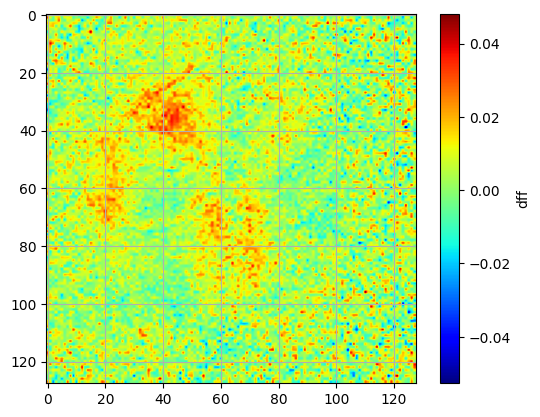

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:43,  2.89it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:42,  2.99it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:38,  3.24it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:41,  3.02it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:39,  3.11it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:38,  3.14it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:37,  3.23it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:40,  2.96it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:39,  3.04it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:38,  3.03it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:37,  3.13it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:37,  3.09it/s]

 10%|████████▏                                                                        | 13/128 [00:04<00:36,  3.16it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:35,  3.19it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:35,  3.17it/s]

 12%|██████████▏                                                                      | 16/128 [00:05<00:36,  3.07it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:37,  2.98it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:36,  3.05it/s]

 15%|████████████                                                                     | 19/128 [00:06<00:37,  2.93it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:36,  2.96it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:37,  2.86it/s]

 17%|█████████████▉                                                                   | 22/128 [00:07<00:35,  3.02it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:34,  3.02it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:35,  2.97it/s]

 20%|███████████████▊                                                                 | 25/128 [00:08<00:33,  3.09it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:32,  3.09it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:32,  3.14it/s]

 22%|█████████████████▋                                                               | 28/128 [00:09<00:32,  3.08it/s]

 23%|██████████████████▎                                                              | 29/128 [00:09<00:32,  3.06it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:32,  2.98it/s]

 24%|███████████████████▌                                                             | 31/128 [00:10<00:32,  2.97it/s]

 25%|████████████████████▎                                                            | 32/128 [00:10<00:33,  2.87it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:31,  3.04it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:11<00:30,  3.08it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:11<00:31,  2.97it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:11<00:29,  3.09it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:12<00:29,  3.06it/s]

 30%|████████████████████████                                                         | 38/128 [00:12<00:28,  3.11it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:12<00:28,  3.13it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:13<00:30,  2.93it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:13<00:29,  2.96it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:13<00:29,  2.94it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:14<00:28,  2.96it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:14<00:27,  3.08it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:14<00:27,  3.03it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:15<00:27,  3.00it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:15<00:27,  2.89it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:15<00:27,  2.88it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:16<00:26,  2.99it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:16<00:26,  2.94it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:16<00:25,  2.97it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:17<00:24,  3.09it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:17<00:25,  2.96it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:17<00:25,  2.86it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:18<00:25,  2.87it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:18<00:25,  2.85it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:18<00:24,  2.91it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:19<00:23,  2.93it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:19<00:23,  2.88it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:19<00:23,  2.90it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:20<00:22,  2.96it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:20<00:23,  2.83it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:21<00:22,  2.87it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:21<00:22,  2.86it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:21<00:21,  2.90it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:21<00:20,  3.02it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:22<00:19,  3.09it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:22<00:19,  3.02it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:22<00:19,  3.10it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:23<00:18,  3.12it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:23<00:18,  3.10it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:23<00:18,  3.10it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:24<00:16,  3.29it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:24<00:15,  3.41it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:24<00:15,  3.34it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:25<00:15,  3.46it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:25<00:14,  3.42it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:25<00:15,  3.21it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:26<00:15,  3.16it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:26<00:15,  3.06it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:26<00:15,  3.12it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:26<00:14,  3.15it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:27<00:14,  3.18it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:27<00:14,  3.08it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:27<00:13,  3.16it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:28<00:13,  3.16it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:28<00:12,  3.26it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:28<00:12,  3.17it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:29<00:12,  3.22it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:29<00:11,  3.26it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:29<00:11,  3.23it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:30<00:11,  3.23it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:30<00:10,  3.32it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:30<00:11,  2.99it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:31<00:10,  3.04it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:31<00:10,  3.02it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:31<00:10,  3.03it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:32<00:10,  2.93it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:32<00:10,  2.89it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:32<00:09,  2.93it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:33<00:09,  2.96it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:33<00:08,  2.98it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:33<00:08,  2.97it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:34<00:08,  2.82it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:34<00:08,  2.81it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:34<00:07,  2.90it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:35<00:07,  2.87it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:35<00:06,  2.98it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:35<00:06,  3.04it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:36<00:06,  3.00it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:36<00:05,  2.92it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:36<00:05,  2.85it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:37<00:05,  2.90it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:37<00:04,  2.86it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:37<00:04,  2.94it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:38<00:04,  2.87it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:38<00:03,  3.03it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:38<00:03,  2.95it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:39<00:03,  2.90it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:39<00:02,  2.84it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:40<00:02,  2.93it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:40<00:02,  2.99it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:40<00:01,  3.05it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:40<00:01,  3.14it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:41<00:00,  3.11it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:41<00:00,  3.21it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:41<00:00,  3.07it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:42<00:00,  3.03it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:42<00:00,  3.03it/s]

frame number 200 plotted


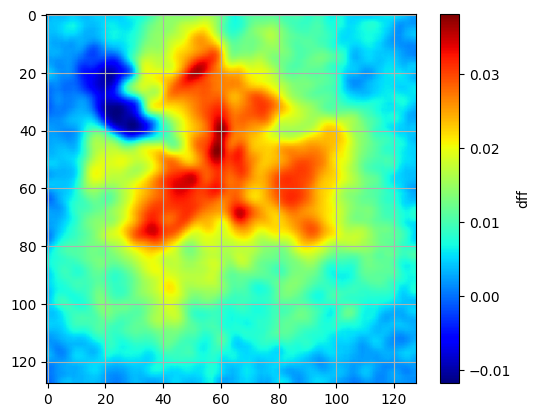

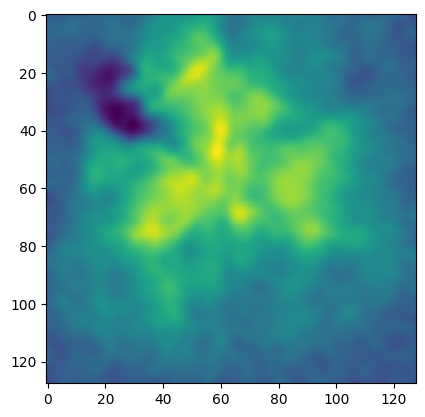

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 12


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 32
fail = 15
total trials = 47


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 12
fail = 29
total trials = 41


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 6
fail = 6
total trials = 12


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/35981 [00:00<?, ?it/s]

  7%|█████▏                                                                    | 2517/35981 [00:00<00:01, 24929.07it/s]

 14%|██████████▎                                                               | 5010/35981 [00:00<00:01, 20200.86it/s]

 20%|██████████████▋                                                           | 7117/35981 [00:00<00:01, 20472.19it/s]

 26%|███████████████████▎                                                      | 9411/35981 [00:00<00:01, 21298.09it/s]

 32%|███████████████████████▋                                                 | 11661/35981 [00:00<00:01, 21637.65it/s]

 40%|████████████████████████████▉                                            | 14269/35981 [00:00<00:00, 23064.64it/s]

 46%|█████████████████████████████████▉                                       | 16707/35981 [00:00<00:00, 23411.50it/s]

 54%|███████████████████████████████████████▏                                 | 19334/35981 [00:00<00:00, 24230.44it/s]

 61%|████████████████████████████████████████████▋                            | 22048/35981 [00:00<00:00, 25051.18it/s]

 68%|█████████████████████████████████████████████████▊                       | 24561/35981 [00:01<00:00, 25064.28it/s]

 75%|██████████████████████████████████████████████████████▉                  | 27073/35981 [00:01<00:00, 24906.42it/s]

 82%|███████████████████████████████████████████████████████████▉             | 29568/35981 [00:01<00:00, 23441.86it/s]

 90%|█████████████████████████████████████████████████████████████████▌       | 32315/35981 [00:01<00:00, 24533.05it/s]

 97%|██████████████████████████████████████████████████████████████████████▌  | 34787/35981 [00:01<00:00, 24168.21it/s]

100%|█████████████████████████████████████████████████████████████████████████| 35981/35981 [00:01<00:00, 23510.61it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25008.52it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25009.27it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")